In this notebook, I will create a function that gives a LIME explanation of every time series regression model.
If we don't have LIME install, we should import it:

In [1]:
%pip install lime
%pip install tslearn
%pip install openpyxl


[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
from lime.lime_tabular import RecurrentTabularExplainer
from tslearn.metrics import dtw
import matplotlib.pyplot as plt
import re
import heapq

def explain_model(X_train, model, x_test, features_names=None):
    explainer = RecurrentTabularExplainer(X_train, mode='regression', feature_names=features_names)
    explained = explainer.explain_instance(x_test, classifier_fn=model.predict, num_samples=90000, num_features=20)
    
    bias_term = explained.intercept[0]
    print(f"Bias LIME term: {bias_term}")
    explained.as_pyplot_figure()
    list(map(lambda x: print(x), explained.as_list()))
    explained.show_in_notebook()

    print("Based on the LIME explanation, the following features had the most influence on the model's prediction:")
    features = explained.as_list()
    features_without_time = {}

    for feature in features:
        # Regex nightmare
        match1 = re.search(r'^(.*?)_t-', feature[0])
        match2 = re.search(r'<\s*(.*?)_t-', feature[0])

        if match1:
            feature_name = match1.group(1)
        if match2:
            feature_name = match2.group(1)

        value = feature[1]

        if feature_name in features_without_time:
            features_without_time[feature_name] += abs(value)
        else:
            features_without_time[feature_name] = abs(value)

    for idx, (name, value) in enumerate(features_without_time.items()):
        if idx < len(features_without_time) - 1:
            print(f"{name}, with a weight of {round(value, 6)}", end=',\n')
        else:
            print(f"{name}, with a weight of {round(value, 6)}", end='.\n')
            
        

    # "Based on the LIME explanation, the following features had the most influence on the model’s prediction:
    # [list of the features with their corresponding weights].
    # The model gave more importance to [feature_x] at time step [t] with a weight of [weight_x_t].
    # For this specific instance, it looks like the model relies heavily on [important feature names] to make its prediction.”

    top_feature = explained.as_list()[0] 
    name = top_feature[0]
    match1 = re.search(r'^(.*?)_t-', name)
    match2 = re.search(r'<\s*(.*?)_t-', name)

    if match1:
        name = match1.group(1)
    if match2:
        name = match2.group(1)

    # Another regex nightmare to get the t-x part of the string
    time_step = top_feature[0]
    match1 = re.match(r'(.+)_t-(\d+) [\S\s]*', time_step)
    if match1:
        time_step = match1.group(2)
    match2 = re.match(r'[^<]+<\s*(\S+)_t-(\d+) [\S\s]*', time_step)
    if match2:
        time_step = match2.group(2)
    
    value = top_feature[1]
    print(f"The model gave the most importance to the feature {name} at time step t-{time_step}, with a weight of {round(value, 6)}")

    print("For this specific instance, it looks like the model relies heavily on", end=' ')

    n = 4
    sorted_features = sorted(features_without_time.items(), key=lambda x: abs(x[1]), reverse=True)
    
    top_n = sorted_features[:n]
    for i, item in enumerate(top_n):
        if i < len(top_n) - 1:
            print(item[0], end=', ')
        else:
            print(item[0], end='.\n')

    return explained
    

I want to also include XCM for Regression. We have to import the file xcm_starter:

In [3]:
from xcm_starter import xcm_start

Let's try to use a few datasets/models to check the result.
First, this Air Quality dataset:

In [4]:
import pandas as pd

df = pd.read_csv("AirQualityUCI.csv", sep=';')


In [5]:
df.tail(6)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
9465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9468,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9470,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot: >

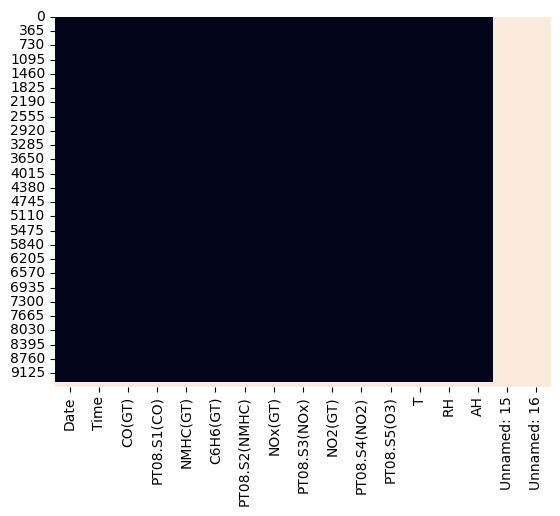

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df.isna(), cbar=False)

Let's drop NaN rows and columns.

In [7]:
df = df.drop(['Unnamed: 15', 'Unnamed: 16'], axis=1)
df = df.dropna()

In [8]:
df.tail(6)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
9351,04/04/2005,09.00.00,"3,9",1297.0,-200.0,"13,6",1102.0,523.0,507.0,187.0,1375.0,1583.0,"18,2","36,3","0,7487"
9352,04/04/2005,10.00.00,"3,1",1314.0,-200.0,"13,5",1101.0,472.0,539.0,190.0,1374.0,1729.0,"21,9","29,3","0,7568"
9353,04/04/2005,11.00.00,"2,4",1163.0,-200.0,"11,4",1027.0,353.0,604.0,179.0,1264.0,1269.0,"24,3","23,7","0,7119"
9354,04/04/2005,12.00.00,"2,4",1142.0,-200.0,"12,4",1063.0,293.0,603.0,175.0,1241.0,1092.0,"26,9","18,3","0,6406"
9355,04/04/2005,13.00.00,"2,1",1003.0,-200.0,"9,5",961.0,235.0,702.0,156.0,1041.0,770.0,"28,3","13,5","0,5139"
9356,04/04/2005,14.00.00,"2,2",1071.0,-200.0,"11,9",1047.0,265.0,654.0,168.0,1129.0,816.0,"28,5","13,1","0,5028"


There are some columns that represent the decimal with commas, and some that represent it with point. Let's uniform that. 

In [9]:
df['CO(GT)'] = df['CO(GT)'].str.replace(',', '.').astype(float)
df['C6H6(GT)'] = df['C6H6(GT)'].str.replace(',', '.').astype(float)
df['T'] = df['T'].str.replace(',', '.').astype(float)
df['RH'] = df['RH'].str.replace(',', '.').astype(float)
df['AH'] = df['AH'].str.replace(',', '.').astype(float)


Let's say we want to predict temperature, so we rename that column as Y:

In [10]:
df = df.rename(columns={'T':'Y'})

In [11]:
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),Y,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,10/03/2004,21.00.00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,10/03/2004,22.00.00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


I want to use a unique column for DateTime.

In [12]:
df['DateTime'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%d/%m/%Y %H.%M.%S')

df = df.drop(['Date', 'Time'], axis=1)

In [13]:
df.head()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),Y,RH,AH,DateTime
0,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004-03-10 18:00:00
1,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004-03-10 19:00:00
2,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004-03-10 20:00:00
3,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,2004-03-10 21:00:00
4,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,2004-03-10 22:00:00


Our index should be DateTime.

In [14]:
df.set_index('DateTime', inplace=True)

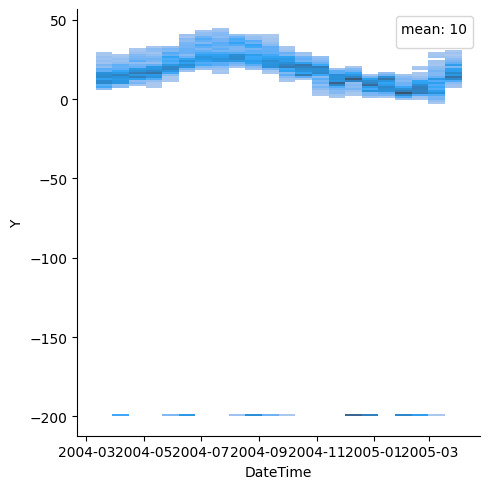

In [15]:
sns.displot(data=df, x='DateTime', y='Y')
plt.legend(title='mean: {:,.0f}'.format(df["Y"].mean()), labels=[])
plt.show()

There are some values that are set to -200 that represent a NaN. I want to substitute them with an interpolation.

In [16]:
import numpy as np
df.replace(-200, np.nan, inplace=True)
df.interpolate(method='linear', axis=0, inplace=True)

Now we generate samples of 7 days.

In [17]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

Let's create the model now:

In [18]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

n_samples = X_train.shape[0]
n_timesteps = X_train.shape[1]
n_features = X_train.shape[2]
model = Sequential()
model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(n_timesteps, n_features)))
model.add(Flatten())
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

model.compile(optimizer='adam', loss='mse')

In [19]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 5, 64)             2560      
                                                                 
 flatten (Flatten)           (None, 320)               0         
                                                                 
 dense (Dense)               (None, 4)                 1284      
                                                                 
 dense_1 (Dense)             (None, 1)                 5         
                                                                 
Total params: 3,849
Trainable params: 3,849
Non-trainable params: 0
_________________________________________________________________


And now we fit the model:

In [20]:
model.fit(X_train, y_train, epochs=100, batch_size=128, validation_data=(X_test, y_test), verbose=1)

Epoch 1/100


2023-05-12 00:21:31.992670: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


59/59 [==============================] - 0s 2ms/step - loss: 133.4880 - val_loss: 39.4316
Epoch 2/100
59/59 [==============================] - 0s 1ms/step - loss: 34.2571 - val_loss: 22.4407
Epoch 3/100
59/59 [==============================] - 0s 1ms/step - loss: 22.6184 - val_loss: 27.1798
Epoch 4/100
59/59 [==============================] - 0s 1ms/step - loss: 18.1731 - val_loss: 16.4086
Epoch 5/100
59/59 [==============================] - 0s 1ms/step - loss: 15.0389 - val_loss: 10.0762
Epoch 6/100
59/59 [==============================] - 0s 1ms/step - loss: 12.9370 - val_loss: 10.1443
Epoch 7/100
59/59 [==============================] - 0s 1ms/step - loss: 11.1203 - val_loss: 16.5174
Epoch 8/100
59/59 [==============================] - 0s 1ms/step - loss: 10.4433 - val_loss: 8.0353
Epoch 9/100
59/59 [==============================] - 0s 1ms/step - loss: 8.8437 - val_loss: 7.0624
Epoch 10/100
59/59 [==============================] - 0s 1ms/step - loss: 8.8881 - val_loss: 6.1946
Epoch

In [21]:
y_pred = model.predict(X_test)
print(y_pred)

59/59 [==============================] - 0s 383us/step
[[11.766997]
 [11.270174]
 [ 9.755713]
 ...
 [26.314554]
 [27.78275 ]
 [28.621727]]


In [22]:
print(y_pred[12])
print(y_test[12])

[4.0096846]
[3.7]


In [23]:
print(y_pred[13])
print(y_test[13])

[3.719004]
[2.6]


In [24]:
from sklearn.metrics import mean_absolute_error
print(mean_absolute_error(y_pred, y_test))

0.7845987141436032


Time for explanation! Let's pass to this function a model and see what it can do:

2813/2813 [==============================] - 1s 420us/step
Bias LIME term: 24.661453511639063
('past_Y_t-1 <= 14.10', -4.0077344327349085)
('past_Y_t-0 <= 14.10', -3.838708938011702)
('past_Y_t-2 <= 14.10', -3.647836510668182)
('PT08.S1(CO)_t-1 <= 937.00', -2.009253536666957)
('49.80 < RH_t-0 <= 62.30', -1.6279629244151712)
('PT08.S1(CO)_t-3 <= 937.00', 1.2016712318549305)
('PT08.S4(NO2)_t-6 <= 1337.26', -1.141536411971835)
('PT08.S1(CO)_t-6 <= 937.00', 1.083161587152391)
('PT08.S1(CO)_t-0 <= 936.75', -1.008793657233382)
('PT08.S2(NMHC)_t-2 <= 763.00', -0.9001168970938412)
('PT08.S5(O3)_t-0 <= 743.42', 0.8598116563957688)
('PT08.S4(NO2)_t-0 <= 1336.75', -0.8058898977176344)
('35.40 < RH_t-3 <= 49.90', -0.7508091836232514)
('PT08.S3(NOx)_t-3 > 979.00', 0.7155048260896679)
('PT08.S4(NO2)_t-4 <= 1337.00', 0.7133735106331295)
('PT08.S3(NOx)_t-2 > 979.00', -0.6910293346208841)
('PT08.S2(NMHC)_t-3 <= 763.00', -0.6886776494251333)
('PT08.S2(NMHC)_t-6 <= 763.00', 0.6835460818492645)
('PT08.S2(

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 12.152455,
PT08.S1(CO), with a weight of 5.30288,
RH, with a weight of 2.378772,
PT08.S4(NO2), with a weight of 2.6608,
PT08.S2(NMHC), with a weight of 2.944902,
PT08.S5(O3), with a weight of 0.859812,
PT08.S3(NOx), with a weight of 1.406534.
The model gave the most importance to the feature past_Y at time step t-1, with a weight of -4.007734
For this specific instance, it looks like the model relies heavily on past_Y, PT08.S1(CO), PT08.S2(NMHC), PT08.S4(NO2).


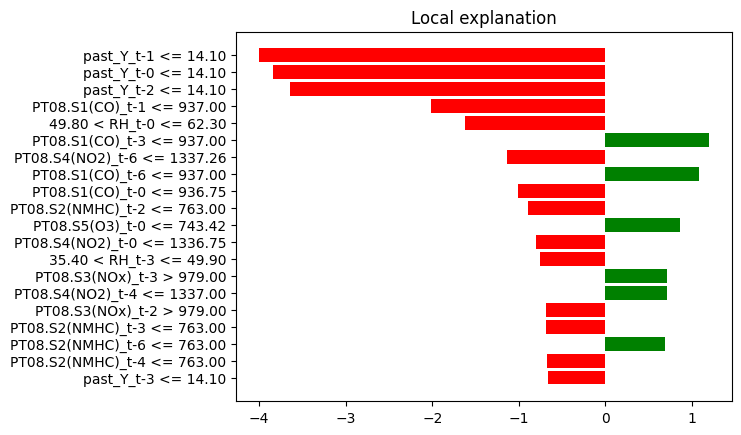

In [25]:
explain_model(X_train, model, X_test[12], features_names=input_features)

2813/2813 [==============================] - 1s 425us/step
Bias LIME term: 24.349185116468895
('past_Y_t-1 <= 14.10', -3.978914506418404)
('past_Y_t-0 <= 14.10', -3.6992218549903253)
('past_Y_t-2 <= 14.10', -3.634053151704956)
('PT08.S1(CO)_t-1 <= 937.00', -1.9471815540177226)
('49.80 < RH_t-0 <= 62.30', -1.5682819400126349)
('PT08.S1(CO)_t-3 <= 937.00', 1.2348186025649628)
('PT08.S4(NO2)_t-6 <= 1337.26', -1.165876405877991)
('PT08.S1(CO)_t-0 <= 936.75', -1.0159216664390294)
('PT08.S2(NMHC)_t-2 <= 763.00', -0.9481561298378116)
('PT08.S4(NO2)_t-0 <= 1336.75', -0.8576127122332206)
('PT08.S5(O3)_t-0 <= 743.42', 0.8450507377113392)
('PT08.S2(NMHC)_t-3 <= 763.00', -0.7916266230533213)
('49.90 < RH_t-3 <= 62.30', 0.7682428643186282)
('PT08.S3(NOx)_t-2 > 979.00', -0.7465055958502443)
('PT08.S3(NOx)_t-3 > 979.00', 0.7280945341965213)
('PT08.S1(CO)_t-5 <= 937.00', 0.7114348576792373)
('PT08.S4(NO2)_t-4 <= 1337.00', 0.7040311375292138)
('past_Y_t-3 <= 14.10', -0.6496934267382388)
('C6H6(GT)_t-1 

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 11.961883,
PT08.S1(CO), with a weight of 4.909357,
RH, with a weight of 2.336525,
PT08.S4(NO2), with a weight of 2.72752,
PT08.S2(NMHC), with a weight of 2.347563,
PT08.S5(O3), with a weight of 0.845051,
PT08.S3(NOx), with a weight of 1.4746,
C6H6(GT), with a weight of 0.643932.
The model gave the most importance to the feature past_Y at time step t-1, with a weight of -3.978915
For this specific instance, it looks like the model relies heavily on past_Y, PT08.S1(CO), PT08.S4(NO2), PT08.S2(NMHC).


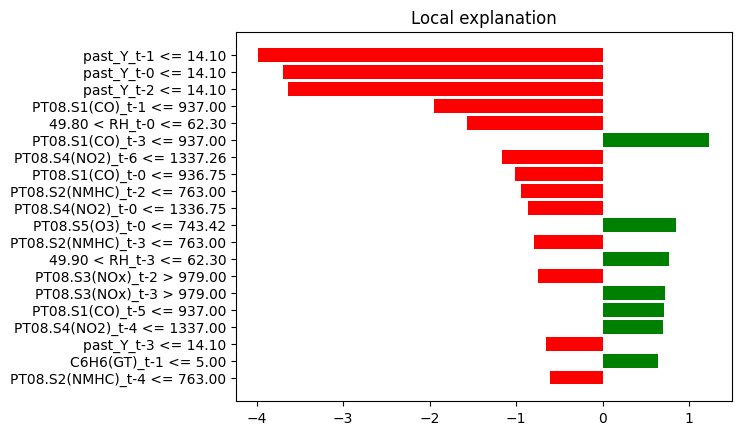

In [26]:
explain_model(X_train, model, X_test[13], features_names=input_features)

As we can see, there is little difference between nearby samples.

Let's try with a different model: LSTM

In [27]:
from keras.models import Sequential
from keras.layers import LSTM, Dense

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(64, input_shape=input_shape))
model.add(Dense(1))


model.compile(optimizer='adam', loss='mse')

In [28]:
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/100
234/234 [==============================] - 2s 3ms/step - loss: 330.9736 - val_loss: 42.3064
Epoch 2/100
234/234 [==============================] - 0s 2ms/step - loss: 185.1856 - val_loss: 35.6373
Epoch 3/100
234/234 [==============================] - 0s 2ms/step - loss: 118.1552 - val_loss: 47.2267
Epoch 4/100
234/234 [==============================] - 0s 2ms/step - loss: 82.7739 - val_loss: 53.0496
Epoch 5/100
234/234 [==============================] - 0s 2ms/step - loss: 64.7376 - val_loss: 64.9676
Epoch 6/100
234/234 [==============================] - 0s 2ms/step - loss: 54.8520 - val_loss: 76.6321
Epoch 7/100
234/234 [==============================] - 0s 2ms/step - loss: 49.9275 - val_loss: 83.4022
Epoch 8/100
234/234 [==============================] - 0s 2ms/step - loss: 44.9963 - val_loss: 63.1687
Epoch 9/100
234/234 [==============================] - 0s 2ms/step - loss: 39.8162 - val_loss: 66.8755
Epoch 10/100
234/234 [==============================] - 0s 2ms/step - 

In [29]:
y_pred = model.predict(X_test)
print(mean_absolute_error(y_pred, y_test))

59/59 [==============================] - 0s 736us/step
2.3671494256953056


In [30]:
print(y_pred[19])
print(y_test[19])

[8.102302]
[8.2]


In [31]:
print(y_pred[20])
print(y_test[20])

[11.252148]
[10.5]


2813/2813 [==============================] - 2s 711us/step
Bias LIME term: 24.940620561598173
('past_Y_t-0 <= 14.10', -4.8814058640112306)
('PT08.S2(NMHC)_t-0 > 1138.00', -2.4372712547660074)
('PT08.S4(NO2)_t-0 <= 1336.75', -2.166609216282086)
('PT08.S3(NOx)_t-0 <= 669.00', 1.3748544734048245)
('PT08.S5(O3)_t-0 > 1285.25', -0.6349238169538098)
('35.30 < RH_t-0 <= 49.80', 0.491399624966362)
('NO2(GT)_t-0 > 126.00', -0.3973836738761795)
('NOx(GT)_t-0 > 308.00', -0.35393927048092183)
('AH_t-0 <= 0.87', -0.2860762171581588)
('CO(GT)_t-0 > 3.00', -0.2794922011304782)
('PT08.S4(NO2)_t-4 <= 1337.00', -0.21718068889531109)
('C6H6(GT)_t-0 > 14.70', -0.20232371579966246)
('1069.00 < PT08.S1(CO)_t-0 <= 1243.00', 0.19352560581425968)
('NMHC(GT)_t-0 <= 275.00', 0.16271200449323878)
('PT08.S4(NO2)_t-6 <= 1337.26', -0.14166790696870143)
('PT08.S2(NMHC)_t-3 > 1138.00', -0.13924983971948865)
('PT08.S1(CO)_t-5 <= 937.00', 0.13136186060252905)
('PT08.S4(NO2)_t-5 <= 1337.00', -0.1225291018925042)
('PT08.S

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 4.881406,
PT08.S2(NMHC), with a weight of 2.576521,
PT08.S4(NO2), with a weight of 2.748635,
PT08.S3(NOx), with a weight of 1.374854,
PT08.S5(O3), with a weight of 0.634924,
RH, with a weight of 0.4914,
NO2(GT), with a weight of 0.397384,
NOx(GT), with a weight of 0.353939,
AH, with a weight of 0.286076,
CO(GT), with a weight of 0.279492,
C6H6(GT), with a weight of 0.202324,
PT08.S1(CO), with a weight of 0.434587,
NMHC(GT), with a weight of 0.162712.
The model gave the most importance to the feature past_Y at time step t-0, with a weight of -4.881406
For this specific instance, it looks like the model relies heavily on past_Y, PT08.S4(NO2), PT08.S2(NMHC), PT08.S3(NOx).


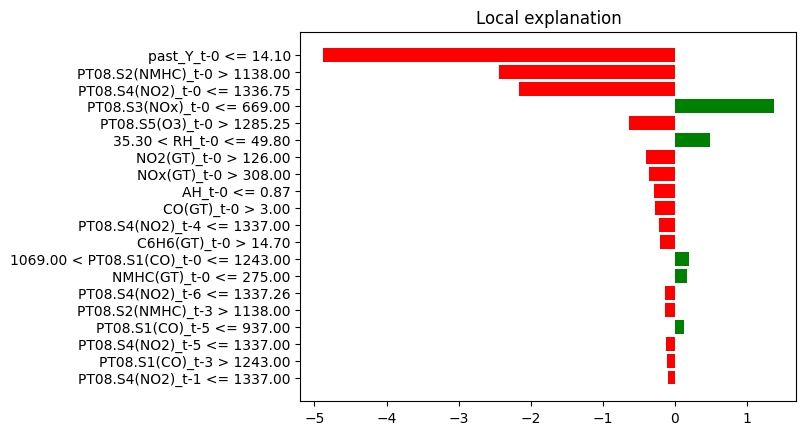

In [32]:
explain_model(X_train, model, X_test[19], input_features)

2813/2813 [==============================] - 2s 715us/step
Bias LIME term: 23.162869244587203
('RH_t-0 <= 35.30', 5.3793979597949475)
('past_Y_t-0 <= 14.10', -4.829982748802006)
('PT08.S4(NO2)_t-0 <= 1336.75', -2.1433593822096224)
('PT08.S3(NOx)_t-0 <= 669.00', 1.40888969570763)
('PT08.S5(O3)_t-0 > 1285.25', -0.7309421387206544)
('933.00 < PT08.S2(NMHC)_t-0 <= 1138.00', -0.6092099033433601)
('NOx(GT)_t-0 > 308.00', -0.3741282259659922)
('NO2(GT)_t-0 > 126.00', -0.3407476490625531)
('AH_t-0 <= 0.87', -0.2700625932878725)
('PT08.S4(NO2)_t-2 <= 1337.00', -0.25015644445344515)
('PT08.S4(NO2)_t-5 <= 1337.00', -0.2010498135628417)
('1069.00 < PT08.S1(CO)_t-0 <= 1243.00', 0.19334216848883867)
('PT08.S4(NO2)_t-6 <= 1337.26', -0.13655948556064615)
('PT08.S1(CO)_t-6 <= 937.00', 0.12923434843335932)
('NMHC(GT)_t-0 <= 275.00', 0.1214020792609838)
('NMHC(GT)_t-1 <= 275.00', -0.12033103850515836)
('past_Y_t-1 <= 14.10', 0.11391193123397308)
('PT08.S3(NOx)_t-3 <= 669.00', 0.10767987322514405)
('past_

Based on the LIME explanation, the following features had the most influence on the model's prediction:
RH, with a weight of 5.379398,
past_Y, with a weight of 5.022803,
PT08.S4(NO2), with a weight of 2.807147,
PT08.S3(NOx), with a weight of 1.51657,
PT08.S5(O3), with a weight of 0.730942,
PT08.S2(NMHC), with a weight of 0.60921,
NOx(GT), with a weight of 0.374128,
NO2(GT), with a weight of 0.340748,
AH, with a weight of 0.270063,
PT08.S1(CO), with a weight of 0.322577,
NMHC(GT), with a weight of 0.241733.
The model gave the most importance to the feature RH at time step t-0, with a weight of 5.379398
For this specific instance, it looks like the model relies heavily on RH, past_Y, PT08.S4(NO2), PT08.S3(NOx).


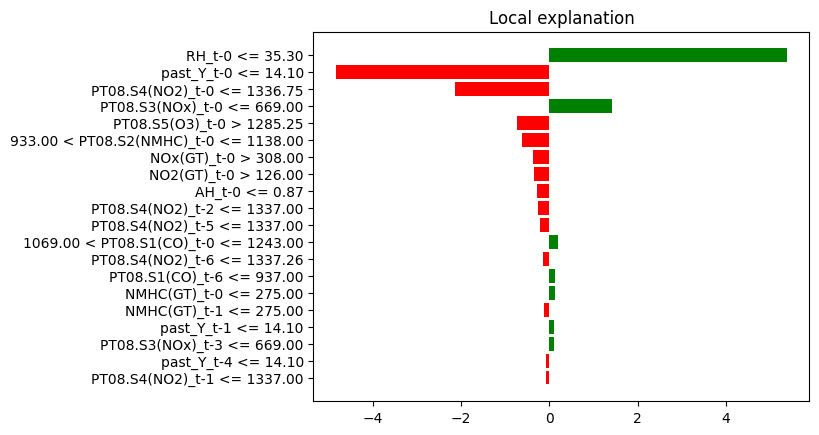

In [33]:
explain_model(X_train, model, X_test[20], features_names=input_features)

Here, the distance between the samples is a bit far. For example:
past_Y_t-0 is close, so their weight is close too (-5.84918385636236 vs -5.838723713979627).
PT08.S2(NMHC)_t-0 is in another threshold, so its weight changes significantly (-3.510987965817944 vs -0.6373512579384727).
PT08.S2(NO2)_t-0: again, same threshold, very close value (-3.428133942095211 vs -3.419279158135313).

And so on.

Let's try to use the XCM Model with explainability-by-design component on this dataset:


Dataset loaded
Training set size: 7480
Testing set size: 1871
X_train.shape:  (7480, 7, 13, 1)
X_test.shape:  (1871, 7, 13, 1)

Training on fold 1
XCM Model Loaded
Epoch 1/100
79/79 [==============================] - 1s 6ms/step - loss: 185.8302 - mean_absolute_error: 12.7535 - val_loss: 332.6855 - val_mean_absolute_error: 17.3456
Epoch 2/100
79/79 [==============================] - 0s 4ms/step - loss: 73.9461 - mean_absolute_error: 7.4846 - val_loss: 217.2297 - val_mean_absolute_error: 13.7914
Epoch 3/100
79/79 [==============================] - 0s 4ms/step - loss: 20.1816 - mean_absolute_error: 3.5825 - val_loss: 154.2112 - val_mean_absolute_error: 11.7070
Epoch 4/100
79/79 [==============================] - 0s 5ms/step - loss: 5.7797 - mean_absolute_error: 1.8460 - val_loss: 60.2537 - val_mean_absolute_error: 7.1476
Epoch 5/100
79/79 [==============================] - 0s 4ms/step - loss: 3.7213 - mean_absolute_error: 1.4930 - val_loss: 23.3941 - val_mean_absolute_error: 3.9425
Epoc

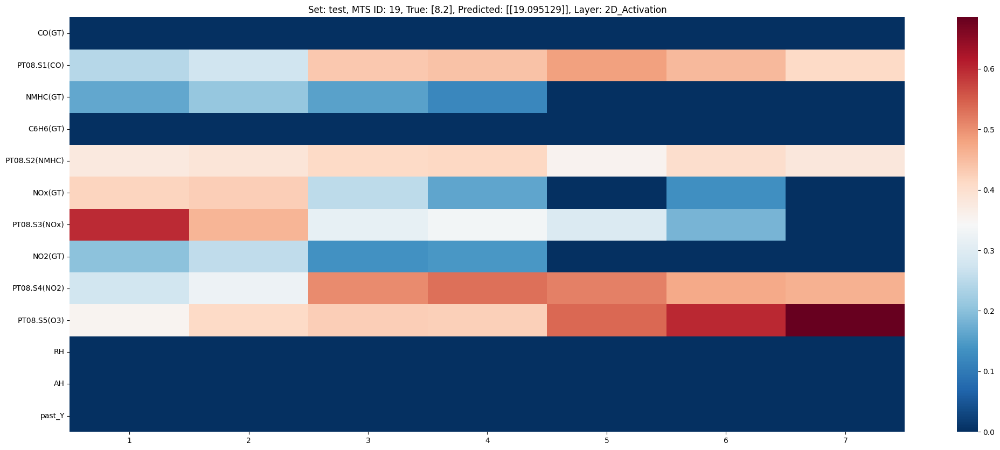

In [34]:
xcm_start(X_train, y_train, X_test, y_test, input_features)

Let's try to use the model of Istanbul Stock Exchange:

In [35]:
df = pd.read_excel("data_akbilgic.xlsx")

In [36]:
df.tail(14)

,date,TL BASED ISE,USD BASED ISE,SP,DAX,FTSE,NIKKEI,BOVESPA,EU,EM
522,2011-02-03,-0.024478,-0.027850,0.002351,0.001392,-0.002804,-0.002489,0.001154,-0.002883,0.000476
523,2011-02-04,0.024507,0.013959,0.002880,0.003127,0.002354,0.010695,-0.022662,0.002761,-0.003185
524,2011-02-07,-0.006196,0.008553,0.006221,0.009298,0.008898,0.004591,0.001424,0.008217,-0.003346
525,2011-02-08,0.005356,0.006886,0.004176,0.005425,0.006638,0.004140,0.006238,0.003980,-0.004499
526,2011-02-09,0.004823,-0.003255,-0.002790,-0.000320,-0.006423,-0.001708,-0.023895,-0.003024,-0.014249
527,2011-02-10,-0.017664,-0.024921,0.000749,0.002644,-0.005351,-0.001148,0.005590,-0.003742,-0.014760
528,2011-02-11,0.004782,0.006418,0.005492,0.004204,0.007101,0.011241,0.018077,0.004727,0.003931
529,2011-02-14,-0.002498,0.000405,0.002382,0.003444,-0.000462,0.000000,0.012123,0.000169,0.013448
530,2011-02-15,0.003606,0.000893,-0.003240,0.000461,-0.003803,0.001968,-0.003266,-0.000550,-0.001430
531,2011-02-16,0.008599,0.013400,0.006238,0.001925,0.007952,0.005717,0.018371,0.006975,0.003039


<AxesSubplot: >

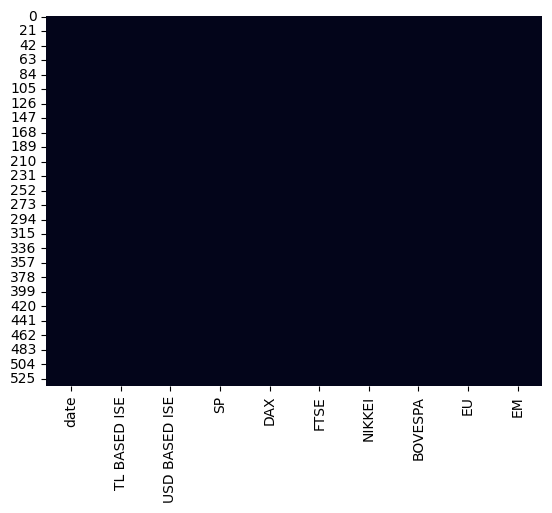

In [37]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df.isna(), cbar=False)

Let's say we want to predict USD Based ISE.

In [38]:
df.set_index('date', inplace=True)
df = df.rename(columns={'USD BASED ISE': 'Y'})

In [39]:
df.head(4)

,TL BASED ISE,Y,SP,DAX,FTSE,NIKKEI,BOVESPA,EU,EM
date,,,,,,,,,
2009-01-05,0.035754,0.038376,-0.004679,0.002193,0.003894,0.000000,0.031190,0.012698,0.028524
2009-01-06,0.025426,0.031813,0.007787,0.008455,0.012866,0.004162,0.018920,0.011341,0.008773
2009-01-07,-0.028862,-0.026353,-0.030469,-0.017833,-0.028735,0.017293,-0.035899,-0.017073,-0.020015
2009-01-08,-0.062208,-0.084716,0.003391,-0.011726,-0.000466,-0.040061,0.028283,-0.005561,-0.019424


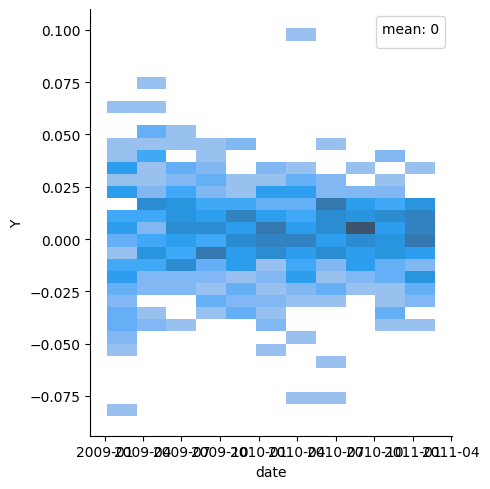

In [40]:
sns.displot(data=df, x='date', y='Y')
plt.legend(title='mean: {:,.0f}'.format(df["Y"].mean()), labels=[])
plt.show()

Let's generate samples, train and test set:

In [41]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

Now the model:

In [42]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

n_samples = X_train.shape[0]
n_timesteps = X_train.shape[1]
n_features = X_train.shape[2]
model = Sequential()
model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(n_timesteps, n_features)))
model.add(MaxPooling1D(pool_size=2))
model.add(Flatten())
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

model.compile(optimizer='adam', loss='mse')

In [43]:
model.fit(X_train, y_train, epochs=100, batch_size=128, validation_data=(X_test, y_test), verbose=1)

Epoch 1/100
4/4 [==============================] - 0s 25ms/step - loss: 4.7039e-04 - val_loss: 2.8364e-04
Epoch 2/100
4/4 [==============================] - 0s 5ms/step - loss: 4.6415e-04 - val_loss: 2.8718e-04
Epoch 3/100
4/4 [==============================] - 0s 5ms/step - loss: 4.6410e-04 - val_loss: 2.8876e-04
Epoch 4/100
4/4 [==============================] - 0s 5ms/step - loss: 4.6152e-04 - val_loss: 2.8819e-04
Epoch 5/100
4/4 [==============================] - 0s 5ms/step - loss: 4.5817e-04 - val_loss: 2.8247e-04
Epoch 6/100
4/4 [==============================] - 0s 5ms/step - loss: 4.5984e-04 - val_loss: 2.7949e-04
Epoch 7/100
4/4 [==============================] - 0s 5ms/step - loss: 4.5755e-04 - val_loss: 2.7959e-04
Epoch 8/100
4/4 [==============================] - 0s 5ms/step - loss: 4.5387e-04 - val_loss: 2.7987e-04
Epoch 9/100
4/4 [==============================] - 0s 4ms/step - loss: 4.5262e-04 - val_loss: 2.8300e-04
Epoch 10/100
4/4 [==============================] - 0s

In [44]:
y_pred = model.predict(X_test)
print(y_pred)

4/4 [==============================] - 0s 595us/step
[[ 7.06182979e-03]
 [-2.43226439e-03]
 [-1.80995595e-02]
 [-1.00981425e-02]
 [ 1.05382251e-02]
 [ 1.23082250e-02]
 [-1.33095682e-03]
 [-2.94724293e-03]
 [-2.89617479e-03]
 [ 1.42449513e-03]
 [ 1.02619184e-02]
 [-3.44530307e-03]
 [ 1.81710720e-03]
 [ 1.89207494e-03]
 [ 9.47333872e-04]
 [ 6.20754249e-03]
 [ 6.61655050e-03]
 [ 6.84433710e-03]
 [-1.21872127e-03]
 [-8.73001106e-03]
 [-1.14126783e-02]
 [-3.37275490e-03]
 [-1.86374169e-02]
 [-1.25535578e-03]
 [ 4.66168113e-03]
 [-3.71118076e-03]
 [-9.32203420e-03]
 [ 5.12583181e-04]
 [ 4.37898003e-03]
 [ 4.42070141e-03]
 [-7.69559108e-03]
 [-5.92037663e-03]
 [ 2.77492404e-03]
 [ 2.90689990e-03]
 [-7.43397698e-03]
 [ 8.50627199e-04]
 [ 3.24681215e-03]
 [-4.21857089e-03]
 [-1.35126095e-02]
 [-4.84979153e-03]
 [ 5.28522581e-03]
 [-6.68085366e-03]
 [-1.98392626e-02]
 [-1.64638963e-02]
 [ 6.84917439e-03]
 [-4.36183438e-03]
 [ 3.63034010e-03]
 [-3.26687656e-03]
 [ 9.63921938e-03]
 [ 6.78116549e-0

In [45]:
print(y_pred[20])
print(y_test[20])

[-0.01141268]
[-0.00814098]


In [46]:
print(y_pred[21])
print(y_test[21])

[-0.00337275]
[-0.00769588]


In [47]:
print(mean_absolute_error(y_pred, y_test))

0.01469745398840288


Ok now let's see the LIME explanation:

2813/2813 [==============================] - 1s 390us/step
Bias LIME term: -0.006589292136939615
('FTSE_t-3 > 0.01', 0.006042503703175737)
('past_Y_t-2 > 0.01', 0.006037086702480664)
('EM_t-3 > 0.01', -0.005710992036078453)
('DAX_t-3 > 0.01', -0.00464288295064435)
('past_Y_t-4 > 0.01', -0.004203404158707213)
('NIKKEI_t-1 <= -0.01', 0.0032488840824361175)
('BOVESPA_t-4 > 0.01', 0.003179769429170033)
('EU_t-3 > 0.01', -0.0017597445658793346)
('BOVESPA_t-6 > 0.01', 0.0016454825357102632)
('-0.01 < SP_t-5 <= 0.00', -0.001458612529115927)
('NIKKEI_t-2 > 0.01', -0.0013233700612989142)
('TL BASED ISE_t-2 <= -0.01', -0.001317076528780645)
('NIKKEI_t-6 <= -0.01', -0.001313936322713202)
('-0.01 < DAX_t-4 <= 0.00', 0.0013015896272007177)
('-0.01 < EM_t-4 <= 0.00', 0.0012533435596647471)
('-0.01 < FTSE_t-4 <= 0.00', -0.001251203153814655)
('-0.01 < past_Y_t-1 <= 0.00', -0.0010545712933427405)
('NIKKEI_t-5 <= -0.01', -0.0010489477334414763)
('TL BASED ISE_t-5 > 0.01', 0.001033678472865864)
('0.00 <

Based on the LIME explanation, the following features had the most influence on the model's prediction:
FTSE, with a weight of 0.007294,
past_Y, with a weight of 0.011295,
EM, with a weight of 0.006964,
DAX, with a weight of 0.005944,
NIKKEI, with a weight of 0.006935,
BOVESPA, with a weight of 0.005851,
EU, with a weight of 0.00176,
SP, with a weight of 0.001459,
TL BASED ISE, with a weight of 0.002351.
The model gave the most importance to the feature FTSE at time step t-3, with a weight of 0.006043
For this specific instance, it looks like the model relies heavily on past_Y, FTSE, EM, NIKKEI.


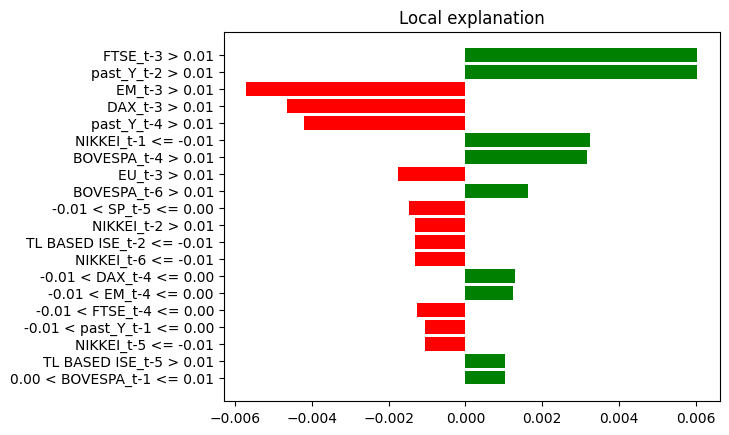

In [48]:
explain_model(X_train, model, X_test[20], features_names=input_features)

2813/2813 [==============================] - 1s 356us/step
Bias LIME term: -0.00588292008483648
('FTSE_t-4 > 0.01', 0.007344497168976005)
('DAX_t-4 > 0.01', -0.005944377343569748)
('EM_t-4 > 0.01', -0.00572391371520353)
('past_Y_t-5 > 0.01', -0.005542084316867823)
('EM_t-1 <= -0.01', 0.003394044460806397)
('EU_t-4 > 0.01', -0.0019118269661168854)
('0.00 < BOVESPA_t-2 <= 0.01', 0.0013842869870635242)
('-0.01 < past_Y_t-2 <= 0.00', -0.0013040860791273317)
('NIKKEI_t-6 <= -0.01', -0.0012876672417999602)
('0.00 < SP_t-5 <= 0.01', 0.001219918152186405)
('-0.01 < past_Y_t-6 <= 0.00', 0.0011873017292610697)
('-0.01 < past_Y_t-4 <= 0.00', 0.0011705899130453987)
('TL BASED ISE_t-2 > 0.01', 0.0011689087610923066)
('NIKKEI_t-2 <= -0.01', 0.0011020359973664445)
('0.00 < SP_t-4 <= 0.01', 0.0010238774977193023)
('0.00 < SP_t-1 <= 0.01', 0.0010056824187019238)
('-0.01 < SP_t-6 <= 0.00', -0.0009996574357265425)
('-0.01 < SP_t-3 <= 0.00', 0.0009020389608850161)
('-0.01 < FTSE_t-3 <= 0.00', -0.000901128

Based on the LIME explanation, the following features had the most influence on the model's prediction:
FTSE, with a weight of 0.008246,
DAX, with a weight of 0.005944,
EM, with a weight of 0.009118,
past_Y, with a weight of 0.009204,
EU, with a weight of 0.001912,
BOVESPA, with a weight of 0.002276,
NIKKEI, with a weight of 0.00239,
SP, with a weight of 0.005151,
TL BASED ISE, with a weight of 0.001169.
The model gave the most importance to the feature FTSE at time step t-4, with a weight of 0.007344
For this specific instance, it looks like the model relies heavily on past_Y, EM, FTSE, DAX.


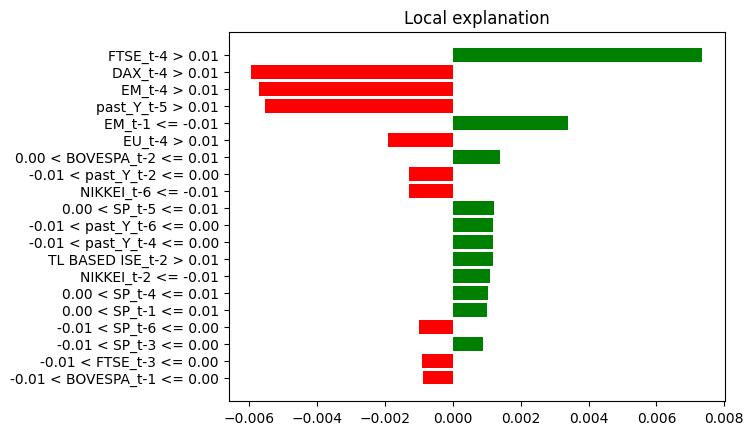

In [49]:
explain_model(X_train, model, X_test[21], features_names=input_features)

Let's try with LSTM:

In [50]:
from keras.models import Sequential
from keras.layers import LSTM, Dense

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(64, input_shape=input_shape))
model.add(Dense(1))


model.compile(optimizer='adam', loss='mse')

In [51]:
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/100
14/14 [==============================] - 1s 23ms/step - loss: 4.6996e-04 - val_loss: 2.7268e-04
Epoch 2/100
14/14 [==============================] - 0s 4ms/step - loss: 3.7719e-04 - val_loss: 2.2564e-04
Epoch 3/100
14/14 [==============================] - 0s 4ms/step - loss: 3.5346e-04 - val_loss: 2.3258e-04
Epoch 4/100
14/14 [==============================] - 0s 4ms/step - loss: 2.7455e-04 - val_loss: 2.0717e-04
Epoch 5/100
14/14 [==============================] - 0s 3ms/step - loss: 2.3535e-04 - val_loss: 1.6394e-04
Epoch 6/100
14/14 [==============================] - 0s 3ms/step - loss: 1.9980e-04 - val_loss: 1.3936e-04
Epoch 7/100
14/14 [==============================] - 0s 3ms/step - loss: 1.7517e-04 - val_loss: 1.3293e-04
Epoch 8/100
14/14 [==============================] - 0s 3ms/step - loss: 1.5415e-04 - val_loss: 1.1691e-04
Epoch 9/100
14/14 [==============================] - 0s 3ms/step - loss: 1.5056e-04 - val_loss: 1.2713e-04
Epoch 10/100
14/14 [================

In [52]:
y_pred = model.predict(X_test)
print(mean_absolute_error(y_pred, y_test))

4/4 [==============================] - 0s 1ms/step
0.004853390432654202


In [53]:
print(y_pred[19])
print(y_test[19])

[0.00701296]
[0.0076885]


2813/2813 [==============================] - 2s 715us/step
Bias LIME term: -0.0016078342873671165
('TL BASED ISE_t-0 > 0.01', 0.031683780678347706)
('TL BASED ISE_t-1 <= -0.01', -0.004633884223250954)
('NIKKEI_t-1 > 0.01', -0.002654865742912043)
('-0.01 < EM_t-0 <= 0.00', -0.0015117521393113193)
('NIKKEI_t-0 <= -0.01', -0.001044210838532999)
('DAX_t-2 > 0.01', -0.000982407720638613)
('-0.01 < past_Y_t-0 <= 0.00', 0.0009574540392394878)
('FTSE_t-2 > 0.01', 0.0008725072465392993)
('-0.01 < EU_t-0 <= 0.00', -0.0007489504554512571)
('0.00 < BOVESPA_t-0 <= 0.01', -0.0006801841572197928)
('NIKKEI_t-5 <= -0.01', -0.0006529872839859824)
('EM_t-2 > 0.01', -0.0006239560951906509)
('NIKKEI_t-4 <= -0.01', -0.0005576768914590715)
('-0.01 < FTSE_t-0 <= 0.00', 0.0005367617230916703)
('TL BASED ISE_t-4 > 0.01', -0.00048380108598164375)
('past_Y_t-3 > 0.01', 0.00048268429645481804)
('BOVESPA_t-3 > 0.01', -0.0004233674570558627)
('-0.01 < SP_t-1 <= 0.00', -0.00041824637800759196)
('0.00 < DAX_t-0 <= 0.0

Based on the LIME explanation, the following features had the most influence on the model's prediction:
TL BASED ISE, with a weight of 0.036801,
NIKKEI, with a weight of 0.00491,
EM, with a weight of 0.002136,
DAX, with a weight of 0.00134,
past_Y, with a weight of 0.00144,
FTSE, with a weight of 0.001409,
EU, with a weight of 0.000749,
BOVESPA, with a weight of 0.001104,
SP, with a weight of 0.000724.
The model gave the most importance to the feature TL BASED ISE at time step t-0, with a weight of 0.031684
For this specific instance, it looks like the model relies heavily on TL BASED ISE, NIKKEI, EM, past_Y.


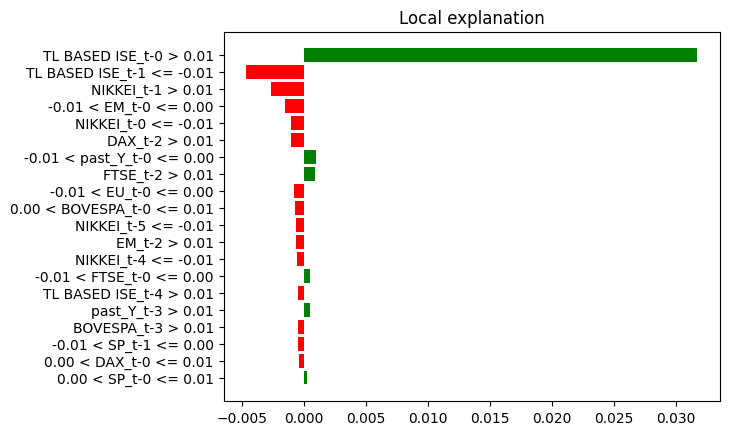

In [54]:
explain_model(X_train, model, X_test[19], input_features)

2813/2813 [==============================] - 2s 709us/step
Bias LIME term: 0.0016196961424164037
('EM_t-0 <= -0.01', -0.0073505895205904686)
('0.00 < TL BASED ISE_t-0 <= 0.01', 0.006145060952928048)
('TL BASED ISE_t-1 > 0.01', 0.004464521138622223)
('NIKKEI_t-1 <= -0.01', 0.002502396996863593)
('FTSE_t-3 > 0.01', 0.0013941001583736958)
('TL BASED ISE_t-2 <= -0.01', -0.001060380929321158)
('0.00 < past_Y_t-0 <= 0.01', -0.0009793830519362876)
('TL BASED ISE_t-5 > 0.01', -0.0008915891641773998)
('DAX_t-3 > 0.01', -0.0008885266891315851)
('0.00 < EU_t-0 <= 0.01', 0.0008856149223428766)
('-0.01 < BOVESPA_t-0 <= 0.00', 0.0008158377755870025)
('0.00 < SP_t-1 <= 0.01', 0.00076831867439603)
('NIKKEI_t-5 <= -0.01', -0.0007416744631556091)
('0.00 < SP_t-0 <= 0.01', 0.0006616462653965897)
('NIKKEI_t-2 > 0.01', -0.0006120373328411707)
('past_Y_t-2 > 0.01', 0.0005011124080858117)
('-0.01 < EM_t-1 <= 0.00', 0.0005006829515305125)
('-0.01 < FTSE_t-1 <= 0.00', 0.00046472262319671546)
('0.00 < FTSE_t-5 

Based on the LIME explanation, the following features had the most influence on the model's prediction:
EM, with a weight of 0.007851,
TL BASED ISE, with a weight of 0.012562,
NIKKEI, with a weight of 0.003856,
FTSE, with a weight of 0.002717,
past_Y, with a weight of 0.00148,
DAX, with a weight of 0.000889,
EU, with a weight of 0.000886,
BOVESPA, with a weight of 0.000816,
SP, with a weight of 0.00143.
The model gave the most importance to the feature EM at time step t-0, with a weight of -0.007351
For this specific instance, it looks like the model relies heavily on TL BASED ISE, EM, NIKKEI, FTSE.


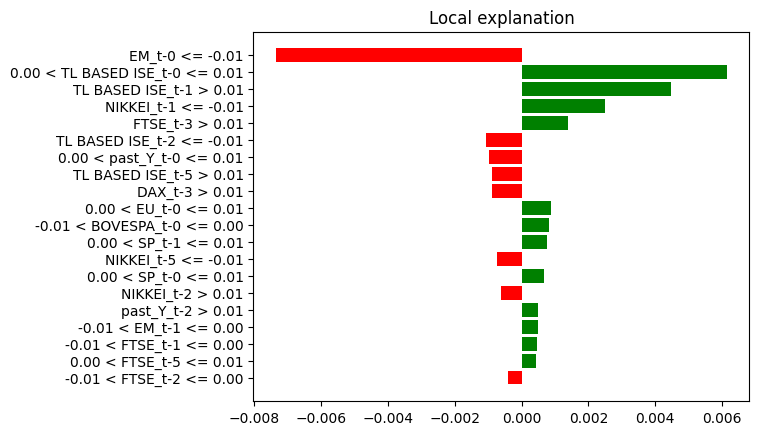

In [55]:
explain_model(X_train, model, X_test[20], features_names=input_features)

Let's check the xcm model:

In [56]:
len(X_train)

424


Dataset loaded
Training set size: 424
Testing set size: 106
X_train.shape:  (424, 7, 9, 1)
X_test.shape:  (106, 7, 9, 1)

Training on fold 1
XCM Model Loaded
Epoch 1/100
5/5 [==============================] - 1s 35ms/step - loss: 0.0566 - mean_absolute_error: 0.1792 - val_loss: 9.6017e-04 - val_mean_absolute_error: 0.0270
Epoch 2/100
5/5 [==============================] - 0s 7ms/step - loss: 0.0299 - mean_absolute_error: 0.1487 - val_loss: 8.8907e-04 - val_mean_absolute_error: 0.0258
Epoch 3/100
5/5 [==============================] - 0s 7ms/step - loss: 0.0073 - mean_absolute_error: 0.0673 - val_loss: 5.6686e-04 - val_mean_absolute_error: 0.0194
Epoch 4/100
5/5 [==============================] - 0s 7ms/step - loss: 0.0023 - mean_absolute_error: 0.0365 - val_loss: 4.5803e-04 - val_mean_absolute_error: 0.0168
Epoch 5/100
5/5 [==============================] - 0s 7ms/step - loss: 0.0012 - mean_absolute_error: 0.0276 - val_loss: 4.4494e-04 - val_mean_absolute_error: 0.0162
Epoch 6/100
5/5

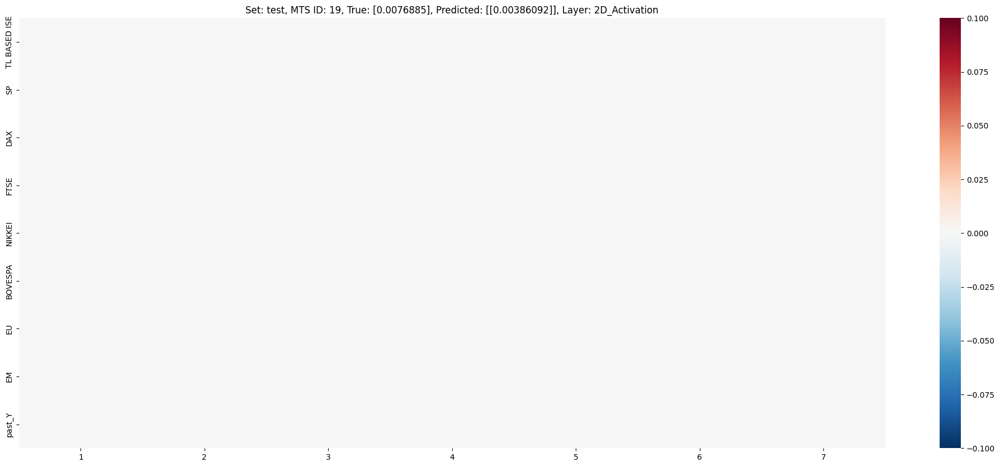

In [57]:
model_xcm = xcm_start(X_train, y_train, X_test, y_test, yticklabels=input_features)

In [58]:
X_test.shape

(106, 7, 9)

In [59]:
X_test_xcm = np.reshape(
    np.array(X_test),
    (X_test.shape[0], X_test.shape[1], X_test.shape[2], 1),
    order="C",
)

model_xcm.predict(X_test_xcm)

4/4 [==============================] - 0s 2ms/step


array([[0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.00386092],
       [0.003

In [60]:
print(y_test)

[[ 0.00660358]
 [ 0.00032606]
 [ 0.01037803]
 [-0.00688954]
 [ 0.00231497]
 [ 0.01277985]
 [ 0.01594248]
 [ 0.01018349]
 [ 0.00878905]
 [-0.01059654]
 [ 0.00824221]
 [ 0.01130961]
 [ 0.02759418]
 [ 0.00088613]
 [ 0.000196  ]
 [ 0.03779504]
 [ 0.00037387]
 [ 0.01568416]
 [-0.00412852]
 [ 0.0076885 ]
 [-0.00814098]
 [-0.00769588]
 [-0.01132673]
 [ 0.02209617]
 [ 0.00179629]
 [ 0.00852098]
 [-0.00640193]
 [-0.0427355 ]
 [ 0.01443257]
 [-0.00130669]
 [ 0.00703944]
 [ 0.04267029]
 [-0.00437412]
 [-0.00573413]
 [ 0.00852324]
 [-0.01660256]
 [-0.01187706]
 [-0.01733661]
 [ 0.00637886]
 [-0.03563273]
 [-0.03754109]
 [-0.00044865]
 [ 0.00353471]
 [-0.02363106]
 [-0.03477944]
 [ 0.01117932]
 [ 0.0191463 ]
 [ 0.016953  ]
 [ 0.0041029 ]
 [ 0.01035651]
 [ 0.0081574 ]
 [-0.01246241]
 [-0.03185293]
 [-0.02008971]
 [ 0.02218826]
 [ 0.00468932]
 [-0.02670327]
 [-0.01964118]
 [-0.0169853 ]
 [-0.01739167]
 [ 0.01821724]
 [ 0.01217666]
 [ 0.0124789 ]
 [ 0.00423297]
 [ 0.000634  ]
 [ 0.00043838]
 [-0.00558

In [61]:
X_test_xcm.shape

(106, 7, 9, 1)

In [62]:
mean_absolute_error(y_test, model_xcm.predict(X_test_xcm))

4/4 [==============================] - 0s 2ms/step


0.012831217633635051

Finally, let's work with a CoVid database:

In [63]:
df = pd.read_csv("datasetCovidLombardy.csv", parse_dates=["data"], index_col="data")
df.head(3)

,stato,codice_regione,denominazione_regione,lat,long,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,...,note,ingressi_terapia_intensiva,note_test,note_casi,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido,codice_nuts_1,codice_nuts_2
data,,,,,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,ITA,3,Lombardia,45.466794,9.190347,76,19,95,71,166,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-02-25 18:00:00,ITA,3,Lombardia,45.466794,9.190347,79,25,104,127,231,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-02-26 18:00:00,ITA,3,Lombardia,45.466794,9.190347,79,25,104,145,249,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


We can see that there are a lot of useless columns: stato, codice_regione, denominazione_regione, lat, long, codice_nuts_1, codice_nuts_2.

Moreover, we see a lot of NaNs, don't we? Let's see:

<AxesSubplot: ylabel='data'>

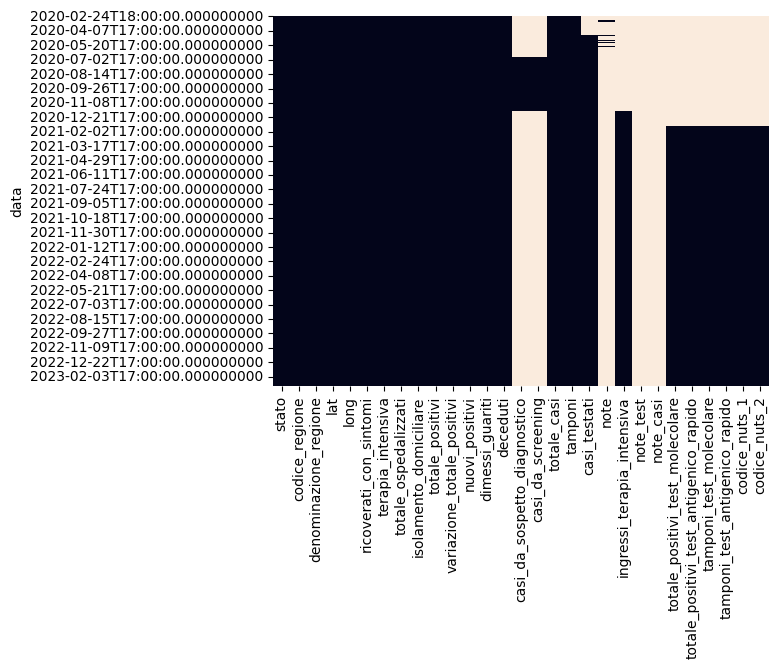

In [64]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df.isna(), cbar = False)

Okay, now that we have a graphical view of this, we can think about deleting some other columns. casi_da_sospetto_diagnostico and casi_da_screening are too few. Same for codice_nuts_1, codice_nuts_2, note, note_test, note_casi. totale_positivi_test_molecolare, totale_positivi_test_antigenico_rapido, tamponi_test_molecolare, tamponi_test_antigenico_rapido could be interesting. Since I have knowledge that prior the first date of the first samples of these, they used only molecular swab, I want to modify these columns in this way:

tamponi_test_antigenico_rapido, totale_positivi_test_antigenico_rapido will be set to 0. tamponi_test_molecolare = tamponi; totale_positivi_test_molecolare = totale_positivi ingressi_terapia_intensiva is not easy, but I think I would set to 0 prior the first insert on this dataset.

In [65]:
df = df.drop('stato', axis=1)
df = df.drop('codice_regione', axis=1)
df = df.drop('denominazione_regione', axis=1)
df = df.drop('lat', axis=1)
df = df.drop('long', axis=1)
df = df.drop('casi_da_sospetto_diagnostico', axis=1)
df = df.drop('casi_da_screening', axis=1)
df = df.drop('note', axis=1)
df = df.drop('note_test', axis=1)
df = df.drop('note_casi', axis=1)
df = df.drop('codice_nuts_1', axis=1)
df = df.drop('codice_nuts_2', axis=1)
df['tamponi_test_antigenico_rapido'] = df['tamponi_test_antigenico_rapido'].fillna(0)
df['totale_positivi_test_antigenico_rapido'] = df['totale_positivi_test_antigenico_rapido'].fillna(0)
df['ingressi_terapia_intensiva'] = df['ingressi_terapia_intensiva'].fillna(0)
df['casi_testati'] = df['casi_testati'].fillna(0)

df['tamponi_test_molecolare'] = df['tamponi_test_molecolare'].fillna(df['tamponi'])
df['totale_positivi_test_molecolare'] = df['totale_positivi_test_molecolare'].fillna(df['totale_positivi'])
df.head()

,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,nuovi_positivi,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,ingressi_terapia_intensiva,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido
data,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,76,19,95,71,166,0,166,0,6,172,1463,0.0,0.0,166.0,0.0,1463.0,0.0
2020-02-25 18:00:00,79,25,104,127,231,65,68,0,9,240,3700,0.0,0.0,231.0,0.0,3700.0,0.0
2020-02-26 18:00:00,79,25,104,145,249,18,18,0,9,258,3208,0.0,0.0,249.0,0.0,3208.0,0.0
2020-02-27 18:00:00,172,41,213,136,349,100,145,40,14,403,3320,0.0,0.0,349.0,0.0,3320.0,0.0
2020-02-28 18:00:00,235,47,282,192,474,125,128,40,17,531,4835,0.0,0.0,474.0,0.0,4835.0,0.0


<AxesSubplot: ylabel='data'>

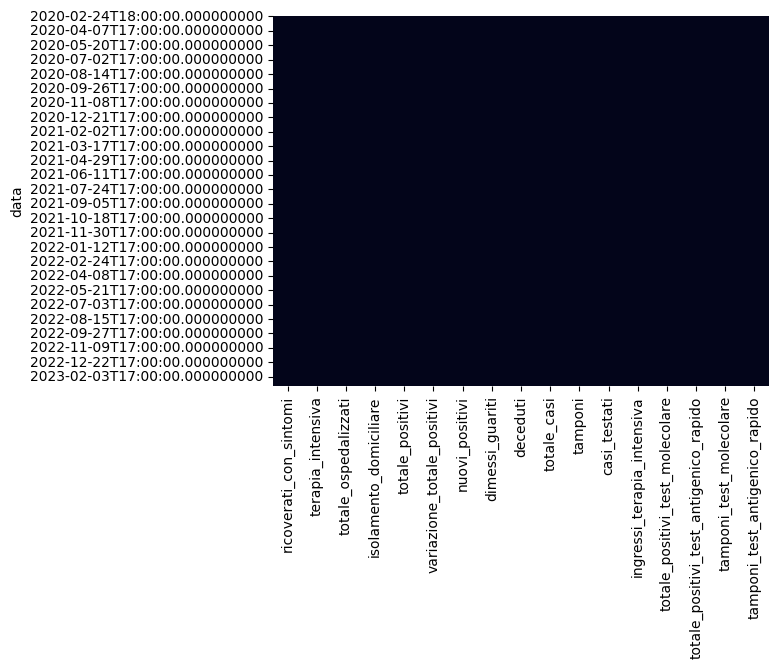

In [66]:
sns.heatmap(df.isna(), cbar = False)

Ok, now that we are NaN-free, we can move on. Let's set as Y the nuovi positivi column

In [67]:
df = df.rename(columns={"nuovi_positivi":"Y"})

In [68]:
df.head()

,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,Y,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,ingressi_terapia_intensiva,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido
data,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,76,19,95,71,166,0,166,0,6,172,1463,0.0,0.0,166.0,0.0,1463.0,0.0
2020-02-25 18:00:00,79,25,104,127,231,65,68,0,9,240,3700,0.0,0.0,231.0,0.0,3700.0,0.0
2020-02-26 18:00:00,79,25,104,145,249,18,18,0,9,258,3208,0.0,0.0,249.0,0.0,3208.0,0.0
2020-02-27 18:00:00,172,41,213,136,349,100,145,40,14,403,3320,0.0,0.0,349.0,0.0,3320.0,0.0
2020-02-28 18:00:00,235,47,282,192,474,125,128,40,17,531,4835,0.0,0.0,474.0,0.0,4835.0,0.0


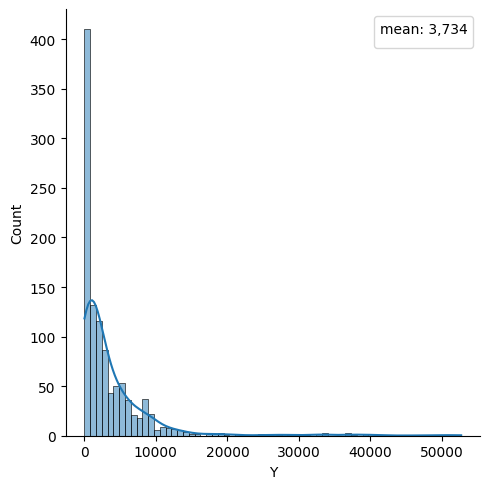

In [69]:
sns.displot(data=df, x="Y", kde=True)
plt.legend(title="mean: {:,.0f}".format(df["Y"].mean()), labels=[])
plt.show()

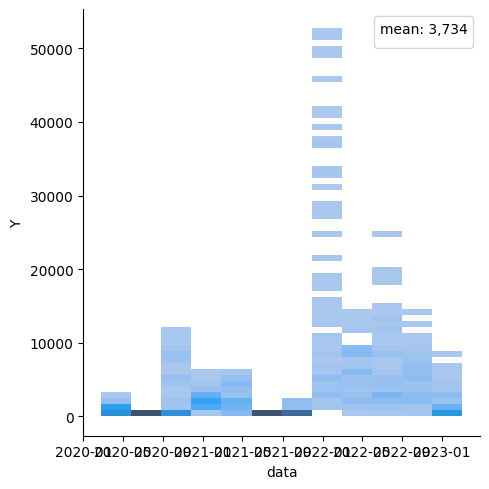

In [70]:
sns.displot(data=df, x="data", y="Y")
plt.legend(title="mean: {:,.0f}".format(df["Y"].mean()), labels=[])
plt.show()

Now it's time to generate samples. In order to create the samples, let's generate a window of 7 days and try to predict the new positives:

In [71]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

In [72]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler

# Normalize the input data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

X_train = scaler_x.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
X_test = scaler_x.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
y_train = scaler_y.fit_transform(y_train)
y_test = scaler_y.transform(y_test)

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(100, input_shape=input_shape, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

optimizer = Adam(learning_rate=0.01)
model.compile(optimizer=optimizer, loss='mse')

# Adding a learning rate scheduler
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(X_train, y_train, epochs=200, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])

# Make predictions using the trained model
y_pred = model.predict(X_test)

# Inverse transform the predictions to the original scale
y_pred = scaler_y.inverse_transform(y_pred)
y_test = scaler_y.inverse_transform(y_test)


Epoch 1/200
55/55 [==============================] - 3s 15ms/step - loss: 0.0352 - val_loss: 0.0025 - lr: 0.0100
Epoch 2/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0065 - val_loss: 0.0020 - lr: 0.0100
Epoch 3/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0052 - val_loss: 0.0019 - lr: 0.0100
Epoch 4/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0062 - val_loss: 0.0019 - lr: 0.0100
Epoch 5/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0054 - val_loss: 0.0021 - lr: 0.0100
Epoch 6/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0051 - val_loss: 0.0019 - lr: 0.0100
Epoch 7/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0044 - val_loss: 0.0082 - lr: 0.0100
Epoch 8/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0056 - val_loss: 0.0098 - lr: 0.0100
Epoch 9/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0050 - val_loss: 0.0019 - lr

In [73]:
print(y_pred)

[[12049.744 ]
 [ 8589.813 ]
 [ 7335.4385]
 [ 6105.2974]
 [ 5643.85  ]
 [ 4680.1904]
 [ 4443.691 ]
 [ 7699.499 ]
 [ 5614.4624]
 [ 5404.4917]
 [ 4827.388 ]
 [ 4473.4956]
 [ 3972.0122]
 [ 3611.6812]
 [ 5411.899 ]
 [ 4373.835 ]
 [ 4208.2734]
 [ 3723.0225]
 [ 3672.4568]
 [ 3218.8723]
 [ 2934.5862]
 [ 4121.0996]
 [ 3336.489 ]
 [ 3638.6943]
 [ 3469.9292]
 [ 3277.1455]
 [ 3094.1594]
 [ 2883.1826]
 [ 3051.9346]
 [ 4687.4785]
 [ 3880.0413]
 [ 3719.7195]
 [ 3781.8984]
 [ 3604.322 ]
 [ 3629.3289]
 [ 4677.463 ]
 [ 4356.916 ]
 [ 4089.254 ]
 [ 4084.6777]
 [ 3930.4429]
 [ 3632.7449]
 [ 3555.1008]
 [ 4505.7783]
 [ 4158.471 ]
 [ 3895.4739]
 [ 3704.2126]
 [ 3492.2395]
 [ 3346.6018]
 [ 3357.7239]
 [ 4151.7617]
 [ 4011.5781]
 [ 3920.3945]
 [ 3802.0286]
 [ 3962.216 ]
 [ 3658.2234]
 [ 3481.7546]
 [ 4687.664 ]
 [ 4478.611 ]
 [ 4449.977 ]
 [ 4344.772 ]
 [ 4053.326 ]
 [ 3754.792 ]
 [ 4677.3696]
 [ 5541.519 ]
 [ 5596.5186]
 [ 5711.444 ]
 [ 5701.2866]
 [ 5758.5215]
 [ 5504.1626]
 [ 5824.2734]
 [ 8700.065 ]
 [ 829

In [74]:
print(y_test)

[[13130.]
 [ 8605.]
 [ 7669.]
 [ 6847.]
 [ 6146.]
 [ 4549.]
 [ 1721.]
 [ 8860.]
 [ 5572.]
 [ 5369.]
 [ 4692.]
 [ 4328.]
 [ 3145.]
 [ 1169.]
 [ 5474.]
 [ 3740.]
 [ 3224.]
 [ 2975.]
 [ 2813.]
 [ 2143.]
 [  947.]
 [  783.]
 [ 4654.]
 [ 3029.]
 [ 2762.]
 [ 2799.]
 [ 2235.]
 [ 1042.]
 [ 4918.]
 [ 3322.]
 [ 3099.]
 [ 3017.]
 [ 2973.]
 [ 2366.]
 [ 1042.]
 [ 4875.]
 [ 3137.]
 [ 2972.]
 [ 2757.]
 [ 2511.]
 [ 1862.]
 [  738.]
 [ 3980.]
 [ 2733.]
 [ 2554.]
 [ 2420.]
 [ 2310.]
 [ 1851.]
 [  778.]
 [ 4364.]
 [ 2871.]
 [ 3004.]
 [ 3110.]
 [ 2868.]
 [  284.]
 [ 2243.]
 [ 5570.]
 [ 3525.]
 [ 3841.]
 [ 3661.]
 [ 4081.]
 [ 3120.]
 [ 1452.]
 [ 8978.]
 [ 6546.]
 [ 6872.]
 [ 6252.]
 [ 5991.]
 [ 4896.]
 [ 1847.]
 [12249.]
 [ 8498.]
 [ 9124.]
 [ 8699.]
 [ 8671.]
 [ 6231.]
 [ 2229.]
 [14025.]
 [ 9126.]
 [ 8771.]
 [ 7991.]
 [ 7701.]
 [ 5653.]
 [ 1864.]
 [12757.]
 [ 8230.]
 [ 7983.]
 [ 6803.]
 [ 6161.]
 [ 4646.]
 [ 1640.]
 [ 9979.]
 [ 6216.]
 [ 6173.]
 [ 5504.]
 [ 4989.]
 [ 3260.]
 [ 1150.]
 [ 6242.]
 [ 1201.]


In [75]:
print(mean_absolute_error(y_pred, y_test))

1611.5899247602983


In [76]:
print(y_pred[50])

[4011.5781]


In [77]:
print(y_pred[51])

[3920.3945]


2813/2813 [==============================] - 8s 3ms/step
Bias LIME term: 0.1364866355639393
('past_Y_t-0 > 0.08', 0.04624739893639087)
('0.03 < past_Y_t-6 <= 0.08', -0.04067542631929764)
('tamponi_test_antigenico_rapido_t-6 > 0.41', 0.029918786989776455)
('tamponi_t-6 > 0.55', -0.02104766319435381)
('tamponi_test_antigenico_rapido_t-5 > 0.41', 0.017437886291000945)
('totale_positivi_test_antigenico_rapido_t-6 > 0.05', -0.016234415715144022)
('0.03 < past_Y_t-5 <= 0.08', -0.015537524586180951)
('tamponi_t-5 > 0.55', -0.014658666435517711)
('dimessi_guariti_t-6 > 0.28', -0.013832832650535688)
('tamponi_test_antigenico_rapido_t-0 > 0.44', 0.013299776343100537)
('0.02 < isolamento_domiciliare_t-0 <= 0.06', -0.012146164025993611)
('tamponi_t-4 > 0.56', -0.01078573754410462)
('0.02 < totale_ospedalizzati_t-6 <= 0.08', 0.010562617734410331)
('tamponi_test_antigenico_rapido_t-4 > 0.42', 0.01006299191961836)
('tamponi_t-0 > 0.57', 0.009735594089710158)
('0.00 < ingressi_terapia_intensiva_t-0 <=

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.111956,
tamponi_test_antigenico_rapido, with a weight of 0.070719,
tamponi, with a weight of 0.056228,
totale_positivi_test_antigenico_rapido, with a weight of 0.025728,
dimessi_guariti, with a weight of 0.013833,
isolamento_domiciliare, with a weight of 0.012146,
totale_ospedalizzati, with a weight of 0.010563,
ingressi_terapia_intensiva, with a weight of 0.009702,
totale_positivi, with a weight of 0.009517,
variazione_totale_positivi, with a weight of 0.009457.
The model gave the most importance to the feature past_Y at time step t-0, with a weight of 0.046247
For this specific instance, it looks like the model relies heavily on past_Y, tamponi_test_antigenico_rapido, tamponi, totale_positivi_test_antigenico_rapido.


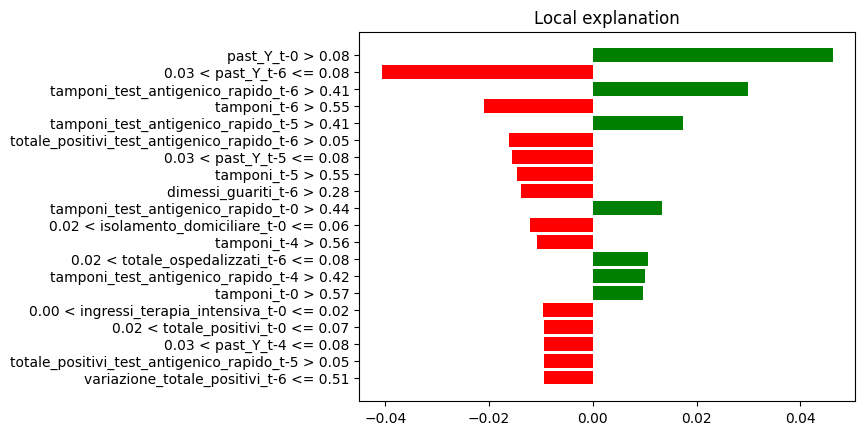

In [78]:
explain_model(X_train, model, X_test[50], input_features)

2813/2813 [==============================] - 7s 2ms/step
Bias LIME term: 0.13974319849457723
('0.03 < past_Y_t-6 <= 0.08', -0.04016330836587228)
('tamponi_test_antigenico_rapido_t-6 > 0.41', 0.030901977479707785)
('tamponi_t-6 > 0.55', -0.021422272279221166)
('tamponi_test_antigenico_rapido_t-5 > 0.41', 0.016770137172393146)
('0.03 < past_Y_t-5 <= 0.08', -0.016420407659064443)
('totale_positivi_test_antigenico_rapido_t-6 > 0.05', -0.015483228202532612)
('dimessi_guariti_t-6 > 0.28', -0.014585812366534784)
('tamponi_test_antigenico_rapido_t-0 > 0.44', 0.013874485016160256)
('tamponi_t-5 > 0.55', -0.012411896678027851)
('past_Y_t-1 > 0.08', 0.011748216490711595)
('0.02 < totale_ospedalizzati_t-6 <= 0.08', 0.010996774424479955)
('tamponi_test_antigenico_rapido_t-4 > 0.42', 0.010459846353369546)
('0.02 < isolamento_domiciliare_t-0 <= 0.06', -0.010366082089288966)
('totale_positivi_test_antigenico_rapido_t-5 > 0.05', -0.010209595454068346)
('casi_testati_t-6 > 0.74', 0.010004419425661288)
(

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.087681,
tamponi_test_antigenico_rapido, with a weight of 0.072006,
tamponi, with a weight of 0.05287,
totale_positivi_test_antigenico_rapido, with a weight of 0.025693,
dimessi_guariti, with a weight of 0.014586,
totale_ospedalizzati, with a weight of 0.010997,
isolamento_domiciliare, with a weight of 0.010366,
casi_testati, with a weight of 0.010004,
totale_positivi, with a weight of 0.009494.
The model gave the most importance to the feature past_Y at time step t-6, with a weight of -0.040163
For this specific instance, it looks like the model relies heavily on past_Y, tamponi_test_antigenico_rapido, tamponi, totale_positivi_test_antigenico_rapido.


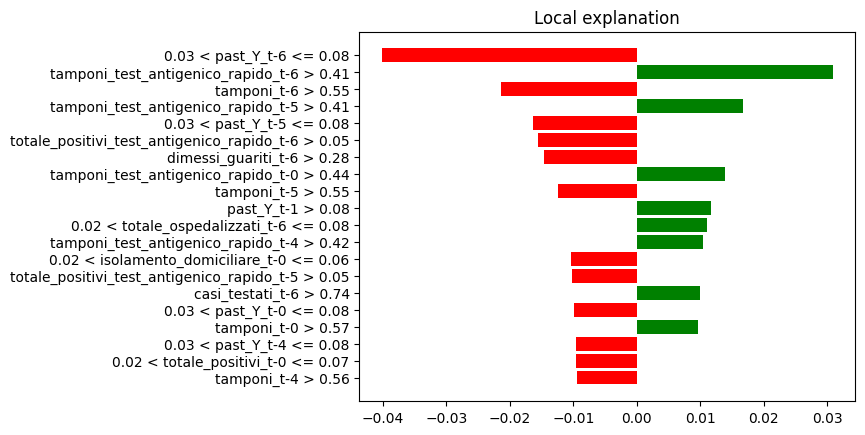

In [79]:
explain_model(X_train, model, X_test[51], input_features)

Again, the features that have the same threshold have basically the same weight. Instead, the features that are in another threshold could have quite different weights. For example:

past_Y_t-0 (different threshold): 0.04688595961668099 vs -0.010033163438212275
past_Y_t-1 (different threshold):  -0.010599422495833618 vs 0.02781955987268119



We can notice that some feature do not seem to be important. For example, totale ospedalizzati or isolamento domiciliare do not appear in the top 20 features. Let's try to reconstruct the model without those features.

In [80]:
df.head()

,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,Y,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,ingressi_terapia_intensiva,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido,past_Y
data,,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,76,19,95,71,166,0,166,0,6,172,1463,0.0,0.0,166.0,0.0,1463.0,0.0,3733.788758
2020-02-25 18:00:00,79,25,104,127,231,65,68,0,9,240,3700,0.0,0.0,231.0,0.0,3700.0,0.0,166.000000
2020-02-26 18:00:00,79,25,104,145,249,18,18,0,9,258,3208,0.0,0.0,249.0,0.0,3208.0,0.0,68.000000
2020-02-27 18:00:00,172,41,213,136,349,100,145,40,14,403,3320,0.0,0.0,349.0,0.0,3320.0,0.0,18.000000
2020-02-28 18:00:00,235,47,282,192,474,125,128,40,17,531,4835,0.0,0.0,474.0,0.0,4835.0,0.0,145.000000


In [81]:
df = df.drop('totale_ospedalizzati', axis=1)
df = df.drop('isolamento_domiciliare', axis=1)

Now let's recreate the train set, test set, compile and fit the model:

In [82]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

In [83]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler

# Normalize the input data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

X_train = scaler_x.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
X_test = scaler_x.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
y_train = scaler_y.fit_transform(y_train)
y_test = scaler_y.transform(y_test)

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(100, input_shape=input_shape, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

optimizer = Adam(learning_rate=0.01)
model.compile(optimizer=optimizer, loss='mse')

# Adding a learning rate scheduler
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(X_train, y_train, epochs=200, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])

# Make predictions using the trained model
y_pred = model.predict(X_test)
# Inverse transform the predictions to the original scale
y_pred = scaler_y.inverse_transform(y_pred)
y_test = scaler_y.inverse_transform(y_test)

Epoch 1/200
55/55 [==============================] - 2s 14ms/step - loss: 0.0523 - val_loss: 0.0043 - lr: 0.0100
Epoch 2/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0082 - val_loss: 0.0098 - lr: 0.0100
Epoch 3/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0069 - val_loss: 0.0055 - lr: 0.0100
Epoch 4/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0046 - val_loss: 0.0041 - lr: 0.0100
Epoch 5/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0060 - val_loss: 0.0080 - lr: 0.0100
Epoch 6/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0061 - val_loss: 0.0018 - lr: 0.0100
Epoch 7/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0040 - val_loss: 0.0019 - lr: 0.0100
Epoch 8/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0053 - val_loss: 0.0019 - lr: 0.0100
Epoch 9/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0052 - val_loss: 0.0020 - lr

In [84]:
print(y_pred)

[[11899.694 ]
 [ 8523.577 ]
 [ 7994.9116]
 [ 6556.835 ]
 [ 6260.4834]
 [ 4861.375 ]
 [ 4070.5264]
 [ 8537.648 ]
 [ 5852.147 ]
 [ 5925.956 ]
 [ 5453.165 ]
 [ 5171.0776]
 [ 4176.6943]
 [ 3402.6936]
 [ 6275.231 ]
 [ 4554.964 ]
 [ 4674.4907]
 [ 4287.188 ]
 [ 4245.525 ]
 [ 3598.0637]
 [ 3012.7732]
 [ 4739.6064]
 [ 3759.4592]
 [ 3928.7537]
 [ 3924.553 ]
 [ 3884.5486]
 [ 3521.5088]
 [ 3080.704 ]
 [ 3172.3928]
 [ 5250.8716]
 [ 4348.7246]
 [ 4292.302 ]
 [ 4294.137 ]
 [ 3952.6858]
 [ 3860.3633]
 [ 5295.6216]
 [ 4797.7593]
 [ 4634.9443]
 [ 4609.6665]
 [ 4477.254 ]
 [ 4042.45  ]
 [ 3832.5046]
 [ 5136.942 ]
 [ 4590.605 ]
 [ 4432.059 ]
 [ 4318.4614]
 [ 4060.7825]
 [ 3785.9727]
 [ 3635.3147]
 [ 4766.9307]
 [ 4491.8604]
 [ 4465.2983]
 [ 4398.282 ]
 [ 4460.7676]
 [ 4067.4854]
 [ 3759.2593]
 [ 5277.4585]
 [ 4911.2793]
 [ 5087.5996]
 [ 4955.109 ]
 [ 4586.7046]
 [ 3921.7554]
 [ 5053.7104]
 [ 6151.049 ]
 [ 5881.816 ]
 [ 6263.8115]
 [ 6262.4375]
 [ 6217.0767]
 [ 5598.844 ]
 [ 5617.5425]
 [ 8649.787 ]
 [ 823

In [85]:
print(y_test)

[[13130.]
 [ 8605.]
 [ 7669.]
 [ 6847.]
 [ 6146.]
 [ 4549.]
 [ 1721.]
 [ 8860.]
 [ 5572.]
 [ 5369.]
 [ 4692.]
 [ 4328.]
 [ 3145.]
 [ 1169.]
 [ 5474.]
 [ 3740.]
 [ 3224.]
 [ 2975.]
 [ 2813.]
 [ 2143.]
 [  947.]
 [  783.]
 [ 4654.]
 [ 3029.]
 [ 2762.]
 [ 2799.]
 [ 2235.]
 [ 1042.]
 [ 4918.]
 [ 3322.]
 [ 3099.]
 [ 3017.]
 [ 2973.]
 [ 2366.]
 [ 1042.]
 [ 4875.]
 [ 3137.]
 [ 2972.]
 [ 2757.]
 [ 2511.]
 [ 1862.]
 [  738.]
 [ 3980.]
 [ 2733.]
 [ 2554.]
 [ 2420.]
 [ 2310.]
 [ 1851.]
 [  778.]
 [ 4364.]
 [ 2871.]
 [ 3004.]
 [ 3110.]
 [ 2868.]
 [  284.]
 [ 2243.]
 [ 5570.]
 [ 3525.]
 [ 3841.]
 [ 3661.]
 [ 4081.]
 [ 3120.]
 [ 1452.]
 [ 8978.]
 [ 6546.]
 [ 6872.]
 [ 6252.]
 [ 5991.]
 [ 4896.]
 [ 1847.]
 [12249.]
 [ 8498.]
 [ 9124.]
 [ 8699.]
 [ 8671.]
 [ 6231.]
 [ 2229.]
 [14025.]
 [ 9126.]
 [ 8771.]
 [ 7991.]
 [ 7701.]
 [ 5653.]
 [ 1864.]
 [12757.]
 [ 8230.]
 [ 7983.]
 [ 6803.]
 [ 6161.]
 [ 4646.]
 [ 1640.]
 [ 9979.]
 [ 6216.]
 [ 6173.]
 [ 5504.]
 [ 4989.]
 [ 3260.]
 [ 1150.]
 [ 6242.]
 [ 1201.]


In [86]:
print(mean_absolute_error(y_pred, y_test))

2090.0746315696024


In [87]:
print(y_pred[50])

[4491.8604]


In [88]:
print(y_pred[51])

[4465.2983]


In [89]:
print(mean_absolute_error(y_pred, y_test))

2090.0746315696024


2813/2813 [==============================] - 6s 2ms/step
Bias LIME term: 0.12629560108226656
('past_Y_t-0 > 0.08', 0.05643495714830465)
('0.03 < past_Y_t-6 <= 0.08', -0.043562757845012144)
('dimessi_guariti_t-6 > 0.28', -0.021241249553353023)
('tamponi_test_molecolare_t-6 > 0.75', -0.01835833308969028)
('tamponi_test_antigenico_rapido_t-0 > 0.44', 0.017633687533750247)
('0.03 < past_Y_t-5 <= 0.08', -0.016715313866028803)
('tamponi_test_antigenico_rapido_t-6 > 0.41', 0.013739308827921149)
('0.02 < totale_positivi_t-0 <= 0.07', -0.01317969822632777)
('totale_positivi_test_antigenico_rapido_t-3 > 0.05', -0.012162370697429602)
('totale_positivi_test_antigenico_rapido_t-2 > 0.05', -0.011879759340750397)
('dimessi_guariti_t-2 > 0.28', -0.01172176538742619)
('deceduti_t-6 > 0.84', 0.011451525791636573)
('0.02 < ricoverati_con_sintomi_t-6 <= 0.09', 0.01111578211618073)
('tamponi_test_antigenico_rapido_t-1 > 0.43', 0.010543087901503895)
('totale_casi_t-6 > 0.29', 0.010419895493520803)
('dimessi

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.116713,
dimessi_guariti, with a weight of 0.043335,
tamponi_test_molecolare, with a weight of 0.018358,
tamponi_test_antigenico_rapido, with a weight of 0.041916,
totale_positivi, with a weight of 0.022271,
totale_positivi_test_antigenico_rapido, with a weight of 0.024042,
deceduti, with a weight of 0.011452,
ricoverati_con_sintomi, with a weight of 0.011116,
totale_casi, with a weight of 0.020177,
variazione_totale_positivi, with a weight of 0.019832.
The model gave the most importance to the feature past_Y at time step t-0, with a weight of 0.056435
For this specific instance, it looks like the model relies heavily on past_Y, dimessi_guariti, tamponi_test_antigenico_rapido, totale_positivi_test_antigenico_rapido.


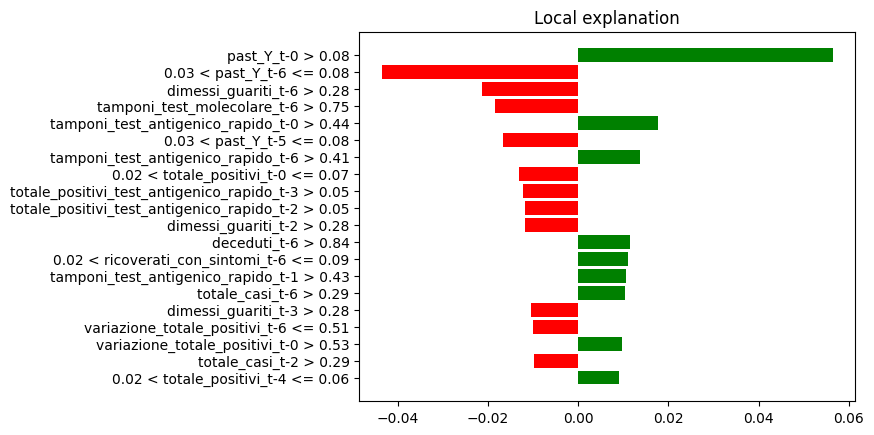

In [90]:
explain_model(X_train, model, X_test[50], input_features)

2813/2813 [==============================] - 6s 2ms/step
Bias LIME term: 0.13850824633259054
('0.03 < past_Y_t-6 <= 0.08', -0.043195196434338265)
('past_Y_t-1 > 0.08', 0.025261097126135987)
('dimessi_guariti_t-6 > 0.28', -0.021376070898968095)
('tamponi_test_molecolare_t-6 > 0.75', -0.01902885207152418)
('tamponi_test_antigenico_rapido_t-0 > 0.44', 0.018651036503743727)
('0.03 < past_Y_t-5 <= 0.08', -0.01636619584464649)
('totale_positivi_test_antigenico_rapido_t-2 > 0.05', -0.012875156184882077)
('0.02 < ricoverati_con_sintomi_t-6 <= 0.09', 0.012563794399835893)
('0.02 < totale_positivi_t-0 <= 0.07', -0.012254676788508239)
('dimessi_guariti_t-2 > 0.28', -0.012142239603809609)
('tamponi_test_antigenico_rapido_t-6 > 0.41', 0.011892368734300576)
('0.03 < past_Y_t-0 <= 0.08', -0.011850029215480819)
('tamponi_test_antigenico_rapido_t-1 > 0.43', 0.011804874718657493)
('deceduti_t-6 > 0.84', 0.010096670522734962)
('0.03 < past_Y_t-4 <= 0.08', -0.009914896165748565)
('dimessi_guariti_t-1 > 0.

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.106587,
dimessi_guariti, with a weight of 0.052901,
tamponi_test_molecolare, with a weight of 0.019029,
tamponi_test_antigenico_rapido, with a weight of 0.042348,
totale_positivi_test_antigenico_rapido, with a weight of 0.012875,
ricoverati_con_sintomi, with a weight of 0.012564,
totale_positivi, with a weight of 0.021573,
deceduti, with a weight of 0.010097,
variazione_totale_positivi, with a weight of 0.009791,
tamponi, with a weight of 0.009614.
The model gave the most importance to the feature past_Y at time step t-6, with a weight of -0.043195
For this specific instance, it looks like the model relies heavily on past_Y, dimessi_guariti, tamponi_test_antigenico_rapido, totale_positivi.


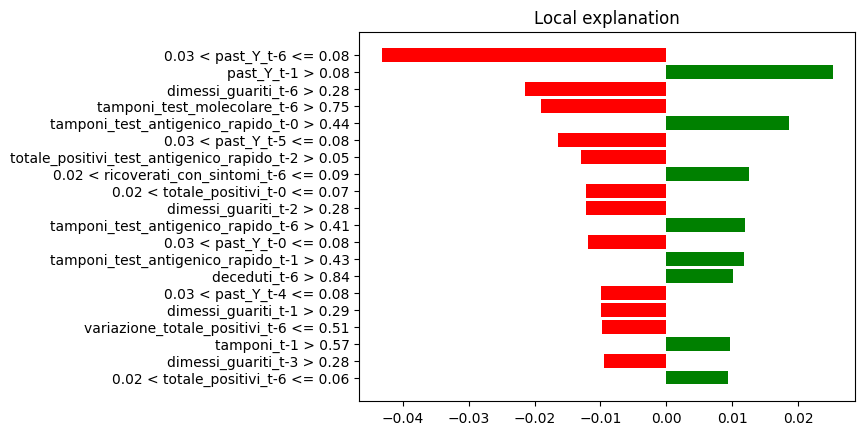

In [91]:
explain_model(X_train, model, X_test[51], input_features)

New experiment: Divide in 5 parts the Covid database, train the same model over every part and see what happens basically.

Epoch 1/100
55/55 [==============================] - 0s 7ms/step - loss: 60725696.0000 - val_loss: 358324.6562 - lr: 1.0000e-04
Epoch 2/100
55/55 [==============================] - 0s 6ms/step - loss: 60693100.0000 - val_loss: 358529.9062 - lr: 1.0000e-04
Epoch 3/100
55/55 [==============================] - 0s 6ms/step - loss: 60685156.0000 - val_loss: 358732.7188 - lr: 1.0000e-04
Epoch 4/100
55/55 [==============================] - 0s 6ms/step - loss: 60703996.0000 - val_loss: 358931.7188 - lr: 1.0000e-04
Epoch 5/100
55/55 [==============================] - 0s 6ms/step - loss: 60718768.0000 - val_loss: 359135.6875 - lr: 1.0000e-04
Epoch 6/100
55/55 [==============================] - 0s 6ms/step - loss: 60653572.0000 - val_loss: 359333.5000 - lr: 1.0000e-04
Epoch 7/100
55/55 [==============================] - 0s 7ms/step - loss: 60699784.0000 - val_loss: 359528.1875 - lr: 1.0000e-04
Epoch 8/100
55/55 [==============================] - 0s 7ms/step - loss: 60690524.0000 - val_loss: 35972

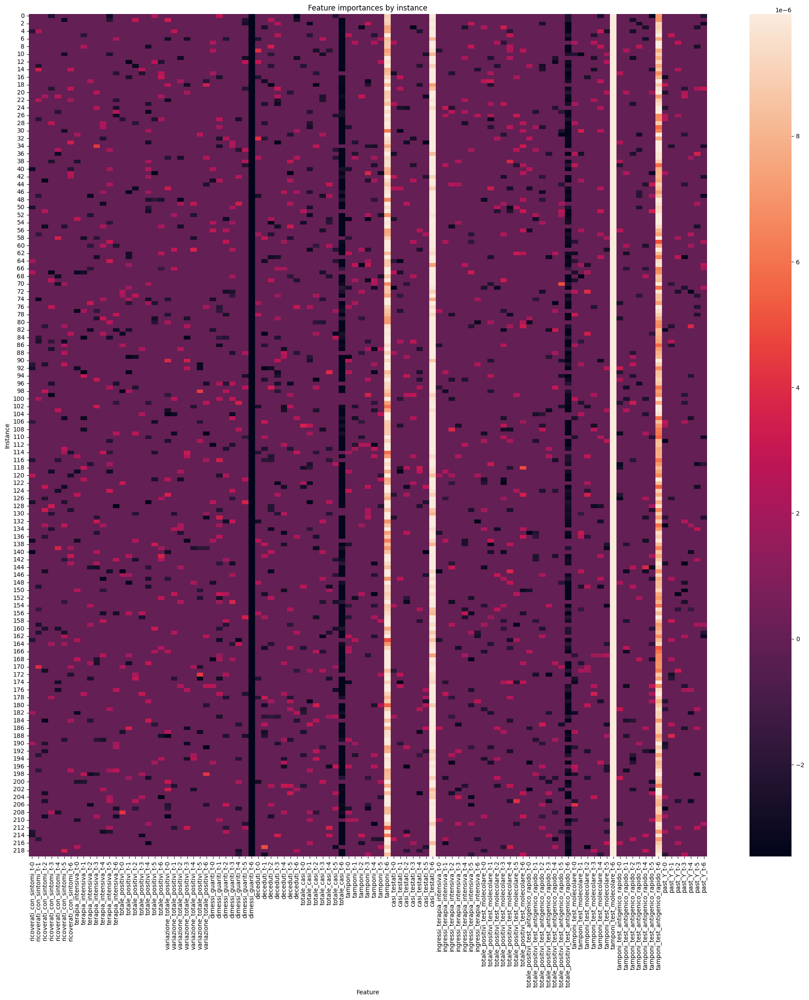

Epoch 1/100
55/55 [==============================] - 0s 8ms/step - loss: 57505092.0000 - val_loss: 11521920.0000 - lr: 1.0000e-04
Epoch 2/100
55/55 [==============================] - 0s 7ms/step - loss: 57533096.0000 - val_loss: 11519849.0000 - lr: 1.0000e-04
Epoch 3/100
55/55 [==============================] - 0s 6ms/step - loss: 57506668.0000 - val_loss: 11517751.0000 - lr: 1.0000e-04
Epoch 4/100
55/55 [==============================] - 0s 6ms/step - loss: 57533140.0000 - val_loss: 11515660.0000 - lr: 1.0000e-04
Epoch 5/100
55/55 [==============================] - 0s 6ms/step - loss: 57526672.0000 - val_loss: 11513608.0000 - lr: 1.0000e-04
Epoch 6/100
55/55 [==============================] - 0s 6ms/step - loss: 57513636.0000 - val_loss: 11511487.0000 - lr: 1.0000e-04
Epoch 7/100
55/55 [==============================] - 0s 6ms/step - loss: 57482800.0000 - val_loss: 11509332.0000 - lr: 1.0000e-04
Epoch 8/100
55/55 [==============================] - 0s 6ms/step - loss: 57504964.0000 - v

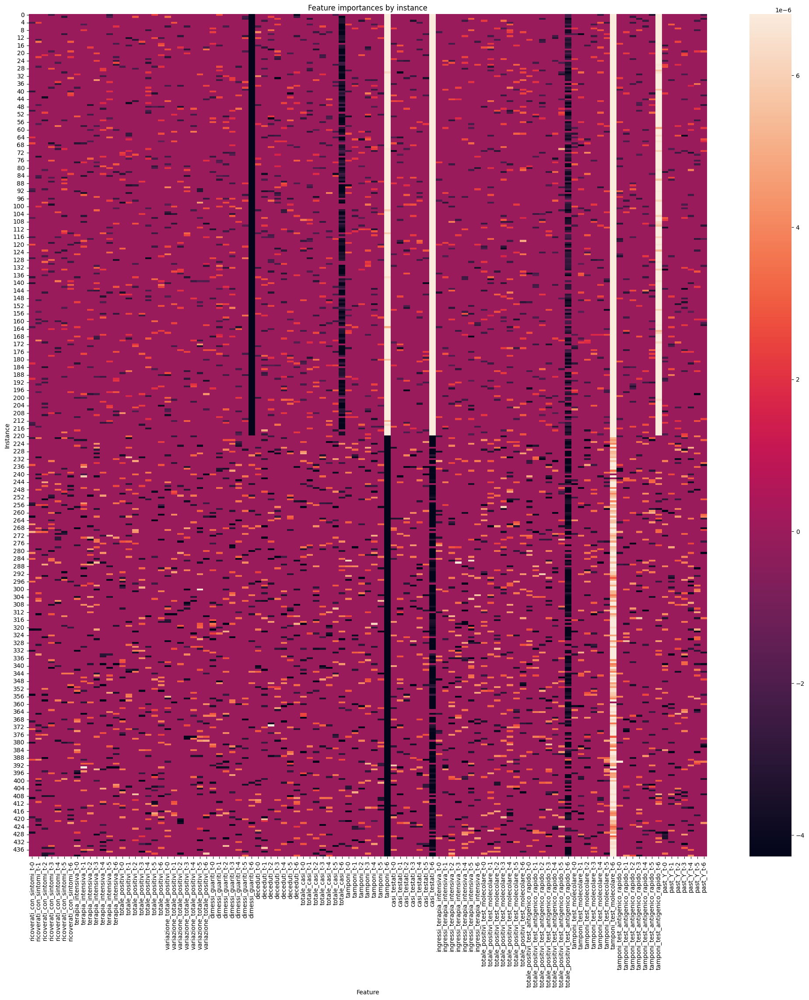

Epoch 1/100
55/55 [==============================] - 0s 8ms/step - loss: 59745328.0000 - val_loss: 1022961.0000 - lr: 1.0000e-04
Epoch 2/100
55/55 [==============================] - 0s 7ms/step - loss: 59751728.0000 - val_loss: 1022928.9375 - lr: 1.0000e-04
Epoch 3/100
55/55 [==============================] - 0s 6ms/step - loss: 59701224.0000 - val_loss: 1022897.3750 - lr: 1.0000e-04
Epoch 4/100
55/55 [==============================] - 0s 6ms/step - loss: 59730152.0000 - val_loss: 1022868.1875 - lr: 1.0000e-04
Epoch 5/100
55/55 [==============================] - 0s 6ms/step - loss: 59714116.0000 - val_loss: 1022838.8125 - lr: 1.0000e-04
Epoch 6/100
55/55 [==============================] - 0s 6ms/step - loss: 59725148.0000 - val_loss: 1022811.3125 - lr: 1.0000e-04
Epoch 7/100
55/55 [==============================] - 0s 6ms/step - loss: 59720232.0000 - val_loss: 1022782.1250 - lr: 1.0000e-04
Epoch 8/100
55/55 [==============================] - 0s 6ms/step - loss: 59735312.0000 - val_loss

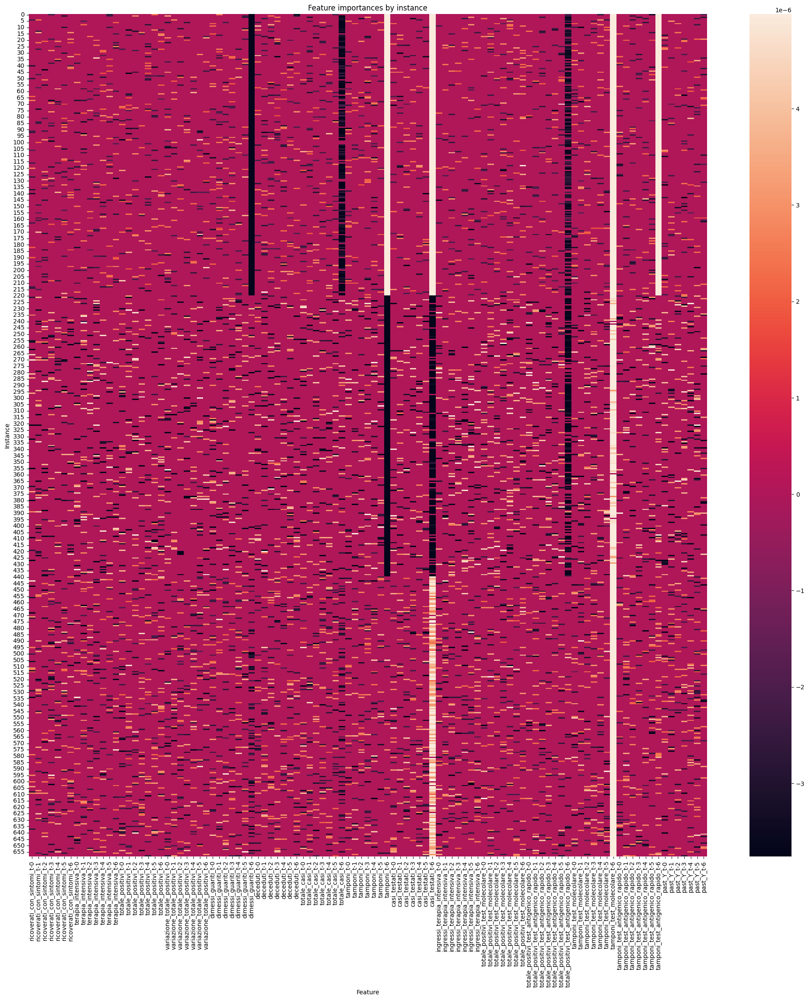

Epoch 1/100
55/55 [==============================] - 0s 7ms/step - loss: 7101348.0000 - val_loss: 210630912.0000 - lr: 1.0000e-04
Epoch 2/100
55/55 [==============================] - 0s 7ms/step - loss: 7079039.0000 - val_loss: 210627648.0000 - lr: 1.0000e-04
Epoch 3/100
55/55 [==============================] - 0s 6ms/step - loss: 7081989.0000 - val_loss: 210624208.0000 - lr: 1.0000e-04
Epoch 4/100
55/55 [==============================] - 0s 6ms/step - loss: 7085651.0000 - val_loss: 210620848.0000 - lr: 1.0000e-04
Epoch 5/100
55/55 [==============================] - 0s 6ms/step - loss: 7092443.5000 - val_loss: 210617344.0000 - lr: 1.0000e-04
Epoch 6/100
55/55 [==============================] - 0s 6ms/step - loss: 7090253.0000 - val_loss: 210613584.0000 - lr: 1.0000e-04
Epoch 7/100
55/55 [==============================] - 0s 6ms/step - loss: 7095730.5000 - val_loss: 210609856.0000 - lr: 1.0000e-04
Epoch 8/100
55/55 [==============================] - 0s 6ms/step - loss: 7088279.5000 - va

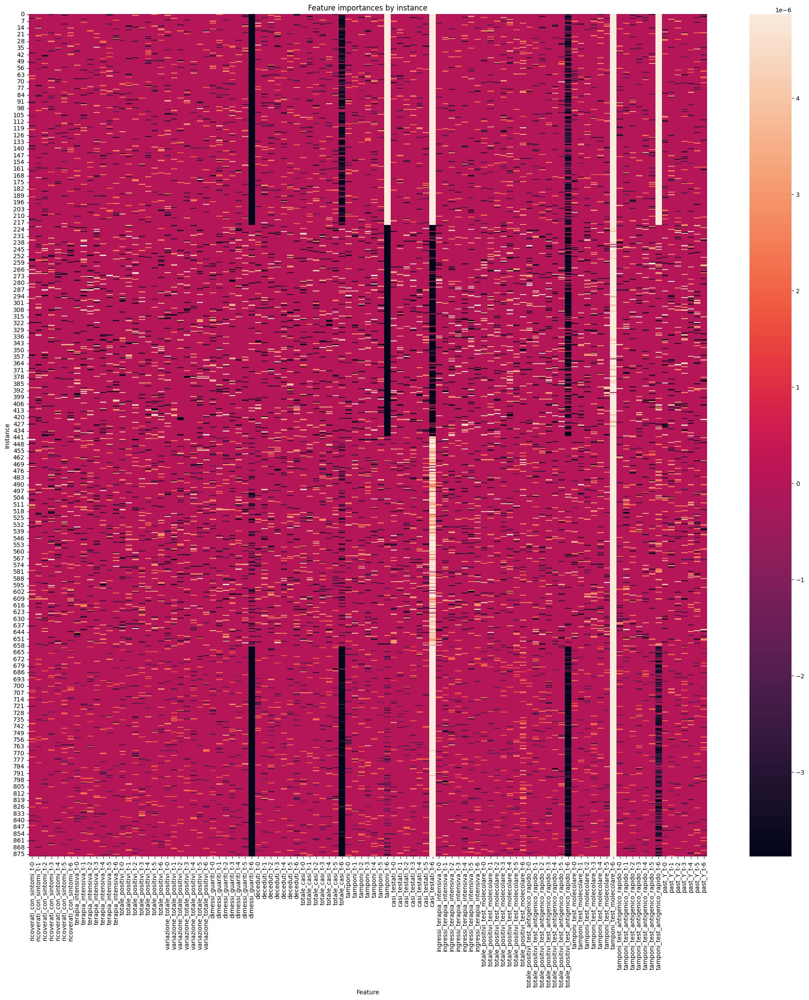

Epoch 1/100
55/55 [==============================] - 0s 7ms/step - loss: 55469684.0000 - val_loss: 15642813.0000 - lr: 1.0000e-04
Epoch 2/100
55/55 [==============================] - 0s 6ms/step - loss: 55486008.0000 - val_loss: 15637645.0000 - lr: 1.0000e-04
Epoch 3/100
55/55 [==============================] - 0s 6ms/step - loss: 55451728.0000 - val_loss: 15632639.0000 - lr: 1.0000e-04
Epoch 4/100
55/55 [==============================] - 0s 6ms/step - loss: 55430896.0000 - val_loss: 15628164.0000 - lr: 1.0000e-04
Epoch 5/100
55/55 [==============================] - 0s 6ms/step - loss: 55430264.0000 - val_loss: 15623660.0000 - lr: 1.0000e-04
Epoch 6/100
55/55 [==============================] - 0s 6ms/step - loss: 55430852.0000 - val_loss: 15619603.0000 - lr: 1.0000e-04
Epoch 7/100
55/55 [==============================] - 0s 6ms/step - loss: 55424788.0000 - val_loss: 15615665.0000 - lr: 1.0000e-04
Epoch 8/100
55/55 [==============================] - 0s 6ms/step - loss: 55406880.0000 - v

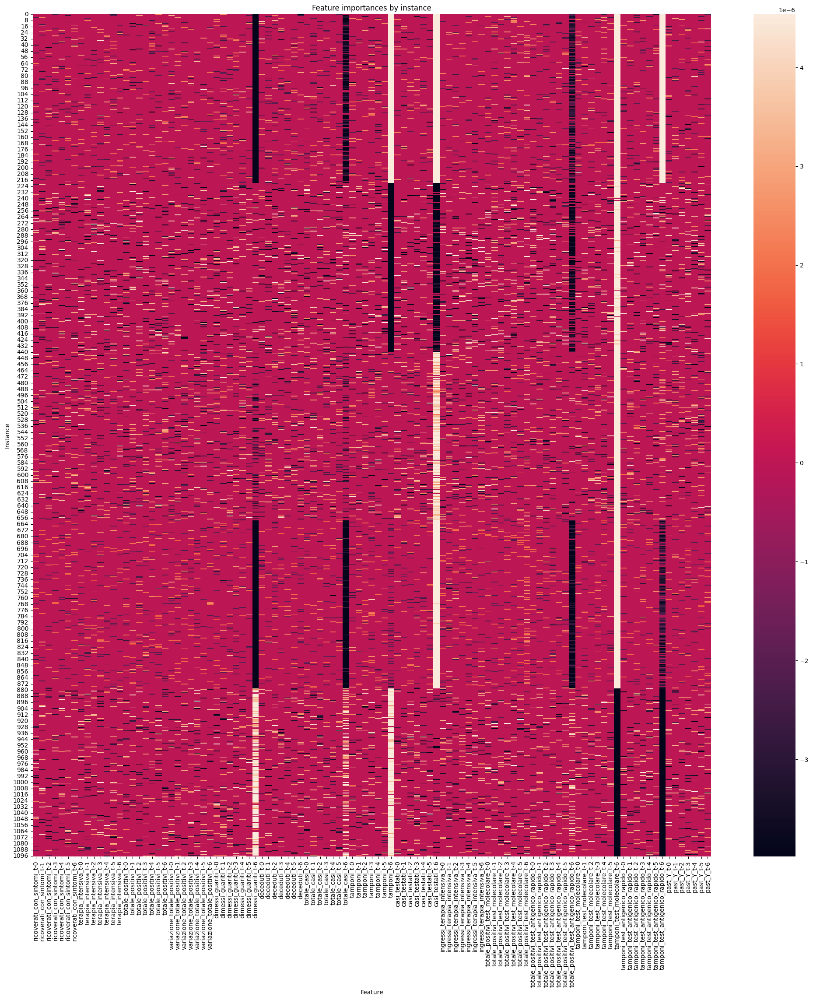

In [99]:
from sklearn.model_selection import KFold

kf = KFold(n_splits=5, shuffle=False)

fold = 1

explanations = []
input_features_list = input_features.tolist()

# Create a new feature list that includes all possible time lags
time_lagged_features = [f"{feature}_t-{i}" for feature in input_features_list for i in range(7)]

for train_index, test_index in kf.split(samples):
    X_train, X_test = samples[train_index], samples[test_index]
    y_train, y_test = labels[train_index], labels[test_index]
    
    # Now you can create and train your model here using X_train, y_train
    # And then test the model using X_test, y_test
    
    # For example
    model.fit(X_train, y_train, epochs=100, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])
    
    y_pred = model.predict(X_test)

    explainer = RecurrentTabularExplainer(X_train, mode='regression', feature_names=input_features)
    for instance in X_test:
        explained = explainer.explain_instance(instance, classifier_fn=model.predict, num_features=15)
        explanations.append(explained)




    # Create a dictionary mapping feature names to indices
    feature_to_index = {feature: index for index, feature in enumerate(time_lagged_features)}

    # Initialize a 2D array of zeros
    feature_importances = np.zeros((len(X_test), len(time_lagged_features)))

    # Fill in the array with feature importances
    for i, exp in enumerate(explanations):

         # If i exceeds the number of rows in feature_importances, create a new array
        if i >= feature_importances.shape[0]:
            feature_importances = np.pad(feature_importances, ((0, len(explanations) - feature_importances.shape[0]), (0, 0)))

        feature_importance_pairs = exp.as_list()

        for feature, importance in feature_importance_pairs:
            # First, we try to match the simpler pattern
            match = re.match(r'([\w_]+_t-\d+)(?: >| <=)? .*', feature)
            
            # If the simpler pattern did not match, we try to match the more complex pattern
            if match is None:
                match = re.match(r'.* ([\w_]+_t-\d+)(?: >| <=)? .*', feature)
            
            if match:
                original_feature = match.group(1)
                feature_index = feature_to_index.get(original_feature)
                if feature_index is not None:
                    feature_importances[i, feature_index] = importance
                else:
                    print(f"Failed to find feature '{original_feature}' in original features")
            else:
                print(f"Failed to extract original feature name from '{feature}'")


            
    # Plot a heatmap of feature importances
    plt.figure(figsize=(25, 25))
    sns.heatmap(feature_importances, xticklabels=time_lagged_features, robust=True)
    plt.xlabel('Feature')
    plt.ylabel('Instance')
    plt.title('Feature importances by instance')
    plt.show()
    
    fold += 1